In [1]:
from itertools import product
import numpy as np
import wandb
import torch
import json
import sys
import os

from torch.profiler import profile, record_function, ProfilerActivity
from ml_collections import ConfigDict
import matplotlib.pyplot as plt
import pandas as pd


# Add the parent directory to the sys.path
parent_dir = os.path.abspath(os.path.join(os.getcwd(), '..'))
sys.path.append(parent_dir)

from Base.utilities import *
#from elliptic2d_files.elliptic2d_mcmc import EllipticMCMC
from elliptic2d_files.utilities import *
from elliptic2d_files.train_elliptic2d import samples_param


device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# Elliptic 2D

$$-\nabla \cdot (a(x,\theta)\nabla u(x,\theta)) = 4x_{1}x_{2}, \quad x\in (0,1)^{2},\theta \in [-1,1]^{N}$$
$$u(x) = 0 \quad x \in \partial D$$

where $a(x,\theta)$ has the following form:
 
$$  
a(x,\theta) = \mu_{a}  +  \sum_{i,j=1}^{k_{i}, k_{j}} \sqrt a_{i,j} \theta_{i,j} b_{i,j}(x)  
$$

where $a_{n} = \frac{1}{4}\exp(- \pi (i^{2}+ j^{2})l^{2})$ and $b_{i,j} = 2 \cos(i \pi x_{1})\cos(j \pi x_{2})$.

In [2]:
def path_results(model_type,marginal_approximation=False,num_layers=2,hidden_dim=20,nn_samples=10,batch_size=10,KL_expansion=2,
                 kernel_spatial="Matern52",kernel_parameter ="SquaredExponential" ,observed_spatial_points=6,observed_solutions=10):
    aprox_type = "marginal" if marginal_approximation else "mean"
    if model_type == "dgala":
        model_id = (
            f"_{aprox_type}"
            f"_hl{num_layers}"
            f"_hd{hidden_dim}"
            f"_s{nn_samples}"
            f"_b{batch_size}"
            f"_kl{KL_expansion}")

    elif model_type == "pigp":
        model_id = (
            f"_{aprox_type}"
            f"_kernel_spatial{kernel_spatial}"
            f"_kernel_parameter{kernel_parameter}"
            f"_spatial{observed_spatial_points}"
            f"_nsol{observed_solutions}"
            f"_kl{KL_expansion}")
        
    elif model_type == "gp":
        model_id = (
            f"_{aprox_type}"
            f"_kernel{kernel_parameter}"
            f"_spatial{observed_spatial_points}"
            f"_nsol{observed_solutions}"
            f"_kl{KL_expansion}")
            
    return os.path.join("./results",f"{model_type}{model_id}.json")

In [3]:
def final_results(model_type,KLs,Nts,batch_size=None,hidden_dim=None,marginal_approximation=False,num_layers=2,
                  kernel_spatial="Matern52",kernel_parameter ="SquaredExponential",observed_spatial_points=6):
    
    metrics = ["alpha", "m_error", "total_cpu_time","total_cuda_time","total_flops"]
    # Initialize dictionaries for mean and std
    results_experiment = {m: {} for m in metrics}
    #results_experiment_std = {m: {} for m in metrics}

    # Initialize lists for each metric
    for metric in metrics:
        for kl in KLs:
            results_experiment[metric][f"{kl}"] = []
            #results_experiment_std[metric][f"{kl}"] = []
    
    if model_type == "dgala":
        for kl, nts,b,hd in zip(KLs, Nts,batch_size,hidden_dim):
            path = path_results(model_type=model_type,KL_expansion=kl,nn_samples = nts,batch_size=b, hidden_dim=hd,
                                marginal_approximation= marginal_approximation,num_layers=num_layers)
            try:
                with open(path, "r") as file:
                    data = json.load(file)  # this will give you a dictionary
            except FileNotFoundError:
                print(f"Warning: File not found at {path}")
                continue

            for metric in data.keys():
                statistic = np.array(data[metric]).mean(), np.array(data[metric]).std()
                results_experiment[metric][f"{kl}"].append(statistic)
                #results_experiment_std[std_res][f"{kl}"].append(statistic[1])
    elif model_type == "dgala2":
        for kl, nts in product(KLs, Nts):
            batch_size_ = 10 if nts < 100 else batch_size
            path = path_results(model_type="dgala",KL_expansion=kl,nn_samples = nts,batch_size=batch_size_, hidden_dim=hidden_dim,
                                marginal_approximation= marginal_approximation,num_layers=num_layers)
            try:
                with open(path, "r") as file:
                    data = json.load(file)  # this will give you a dictionary
            except FileNotFoundError:
                print(f"Warning: File not found at {path}")
                continue

            for metric in data.keys():
                if metric =="total_cpu_time":
                    datos = data[metric][1:]
                else:
                    datos = data[metric]
                
                statistic = np.array(datos).mean(), np.array(datos).std()
                results_experiment[metric][f"{kl}"].append(statistic)
                #results_experiment_std[std_res][f"{kl}"].append(statistic[1])


    else:
        for kl, nts in product(KLs, Nts):
            path = path_results(model_type=model_type,KL_expansion=kl,observed_solutions=nts,marginal_approximation= marginal_approximation,
                                kernel_spatial=kernel_spatial,kernel_parameter =kernel_parameter,
                                observed_spatial_points=observed_spatial_points)

            try:
                with open(path, "r") as file:
                    data = json.load(file)  # this will give you a dictionary
            except FileNotFoundError:
                print(f"Warning: File not found at {path}")
                continue # this will give you a dictionary

            for metric  in data.keys():
                if metric =="total_cpu_time":
                    datos = data[metric][1:]
                else:
                    datos = data[metric]
                
                statistic = np.array(datos).mean(), np.array(datos).std()
                results_experiment[metric][f"{kl}"].append(statistic)
                #results_experiment_std[std_res][f"{kl}"].append(statistic[1])

    return results_experiment

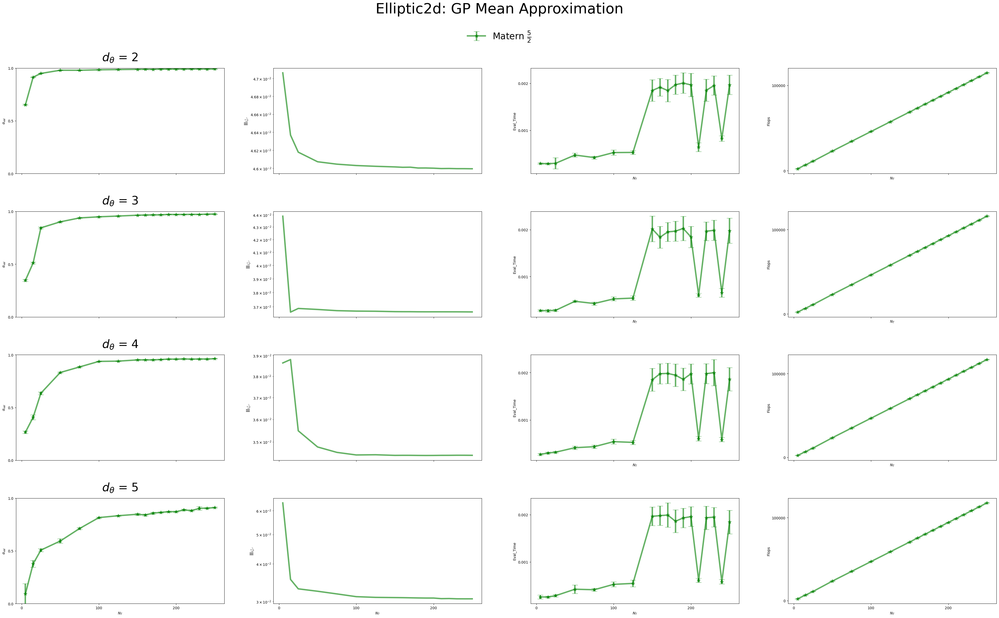

In [4]:
model_type = ["pigp"]
Nts = [5, 15, 25, 50,75,100,125,150,160,170,180,190,200,210,220,230,240,250]
KLs = [2, 3, 4, 5]

res_mean_se,res_std_se = {},{}
res_mean_ma,res_std_ma = {},{}

results_experiment = final_results("pigp",KLs,Nts,kernel_spatial="Matern52",kernel_parameter ="Matern52")

fig, axs = plt.subplots(len(KLs),4, figsize=(40, 25), sharex=True)
fig.suptitle("Elliptic2d: GP Mean Approximation", fontsize = 40)
plt.rcParams.update({'font.size': 50})

for i,k in enumerate(KLs):
    axs[i, 0].set_title(f"$d_{{\\theta}}$ = {k}", fontsize=32, pad=20)

    # Example usage:
    mean, std = np.array(results_experiment["alpha"][str(k)]).T
    #axs[i,0].errorbar(Nts, res_mean_se[model]["alpha_res"][str(k)], yerr=res_std_se[model]["alpha_res"][str(k)], fmt="o-", capsize=8, label=f"SE",color="blue",linewidth=4,markersize=10, alpha=0.6)
    axs[i,0].errorbar(Nts, mean, yerr=std, fmt="*-", capsize=8, label=f"Matern $\\frac{{5}}{{2}}$", color="green",linewidth=4,markersize=10,alpha=0.6)

    axs[i,0].set_ylim((0,1))
    axs[i,0].set_ylabel("$\\alpha_{{val}}$")

    mean, std = np.array(results_experiment["m_error"][str(k)]).T
    #axs[i,1].semilogy(Nts, res_mean_se[model]["error"][str(k)],label=f"SE",color="blue",linewidth=4,markersize=10, alpha=0.6)
    axs[i,1].semilogy(Nts, mean,label=f"Matern $\\frac{{5}}{{2}}$", color="green",linewidth=4,markersize=10, alpha=0.6)
    axs[i,1].set_ylabel("$\\| \\|_{L_{\\mu^{y,F}}^{2}}$")
        
    mean, std = np.array(results_experiment["total_cpu_time"][str(k)]).T
    #axs[i,2].errorbar(Nts, res_mean_se[model]["total_cpu_time"][str(k)],yerr=res_std_se[model]["total_cpu_time"][str(k)], fmt="o-", capsize=8, label=f"SE",color="blue",linewidth=4,markersize=10, alpha=0.6)
    axs[i,2].errorbar(Nts, mean,std, fmt="*-", capsize=8, label=f"Matern $\\frac{{5}}{{2}}$", color="green",linewidth=4,markersize=10,alpha=0.6)
    axs[i,2].set_xlabel("$N_{{T}}$")
    axs[i,2].set_ylabel("Eval_Time")

    mean, std = np.array(results_experiment["total_flops"][str(k)]).T
    #axs[i,3].errorbar(Nts, res_mean_se[model]["total_flops"][str(k)],yerr=res_std_se[model]["total_flops"][str(k)], fmt="o-", capsize=8, label=f"SE",color="blue",linewidth=4,markersize=10, alpha=0.6)
    axs[i,3].errorbar(Nts, mean,yerr=std, fmt="*-", capsize=8, label=f"Matern $\\frac{{5}}{{2}}$", color="green",linewidth=4,markersize=10,alpha=0.6)
    axs[i,3].set_xlabel("$N_{{T}}$")
    axs[i,3].set_ylabel("Flops")

axs[-1,0].set_xlabel("$N_{{T}}$"), axs[-1,1].set_xlabel("$N_{{T}}$"),axs[-1,2].set_xlabel("$N_{{T}}$")

plt.tight_layout(rect=[0, 0, 1, 0.985])  # leave space for both title and legend

# --- ADD HORIZONTAL LEGEND ON TOP ---
handles, labels = axs[0, 0].get_legend_handles_labels()
fig.legend(handles, labels,loc="upper center", ncol=2, fontsize=25, frameon=False, bbox_to_anchor=(0.5, 0.95))
#plt.savefig(f"./results/images/bvp1d_gp_mean_convergence.jpg", bbox_inches='tight') 
#plt.savefig(f"./results/images/elliptic2d_gp_mean_convergence.jpg", bbox_inches='tight') 

In [5]:
k = str(5)  # whatever k is, ensure it's a string

data = {"alpha": results_experiment["alpha"][k],"m_error": results_experiment["m_error"][k],
        "time": results_experiment["total_cpu_time"][k],"time_GPU": results_experiment["total_cuda_time"][k]}
df = pd.DataFrame(data)
df = df.set_index(pd.Index(Nts))
print(df)

                                          alpha  \
5    (0.09310000073164701, 0.09555682219107792)   
15   (0.37737999856472015, 0.03222610546933339)   
25   (0.5071599960327149, 0.014720004201747986)   
50    (0.5931400001049042, 0.02074247453152262)   
75   (0.7115900039672851, 0.009351202160659842)   
100  (0.8152999937534332, 0.005955494981710696)   
125  (0.8330899953842164, 0.004971002351031226)   
150  (0.8470299959182739, 0.008739337490894722)   
160  (0.8396899998188019, 0.009623668578220492)   
170    (0.8575400054454804, 0.0101832429976868)   
180  (0.8645100057125091, 0.005536135647006232)   
190  (0.8714100062847138, 0.006145153733983744)   
200  (0.8713500022888183, 0.006324434621093299)   
210   (0.888069999217987, 0.006998583440005181)   
220  (0.8812799990177155, 0.007600371387753062)   
230    (0.9035099983215332, 0.0172723192878691)   
240  (0.9045199990272522, 0.007069623794359274)   
250  (0.9105099976062775, 0.005551480059740017)   

                              

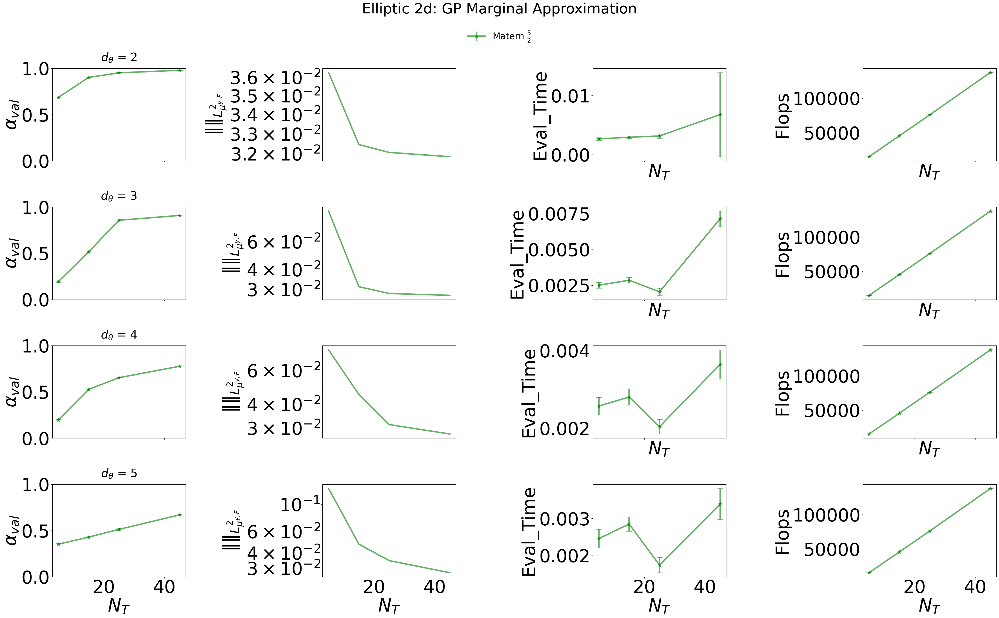

In [6]:
model_type = ["pigp"]
Nts = [5, 15, 25, 45]
KLs = [2, 3, 4, 5]

results_experiment = final_results("pigp",KLs,Nts,kernel_spatial="Matern52",kernel_parameter ="Matern52",marginal_approximation=True)

fig, axs = plt.subplots(len(KLs),4, figsize=(40, 25), sharex=True)
fig.suptitle("Elliptic 2d: GP Marginal Approximation", fontsize = 40)
plt.rcParams.update({'font.size': 50})

for i,k in enumerate(KLs):
    axs[i, 0].set_title(f"$d_{{\\theta}}$ = {k}", fontsize=32, pad=20)

    # Example usage:
    mean, std = np.array(results_experiment["alpha"][str(k)]).T
    #axs[i,0].errorbar(Nts, res_mean_se[model]["alpha_res"][str(k)], yerr=res_std_se[model]["alpha_res"][str(k)], fmt="o-", capsize=8, label=f"SE",color="blue",linewidth=4,markersize=10, alpha=0.6)
    axs[i,0].errorbar(Nts, mean, yerr=std, fmt="*-", capsize=8, label=f"Matern $\\frac{{5}}{{2}}$", color="green",linewidth=4,markersize=10,alpha=0.6)

    axs[i,0].set_ylim((0,1))
    axs[i,0].set_ylabel("$\\alpha_{{val}}$")

    mean, std = np.array(results_experiment["m_error"][str(k)]).T
    #axs[i,1].semilogy(Nts, res_mean_se[model]["error"][str(k)],label=f"SE",color="blue",linewidth=4,markersize=10, alpha=0.6)
    axs[i,1].semilogy(Nts, mean,label=f"Matern $\\frac{{5}}{{2}}$", color="green",linewidth=4,markersize=10, alpha=0.6)
    axs[i,1].set_ylabel("$\\| \\|_{L_{\\mu^{y,F}}^{2}}$")
        
    mean, std = np.array(results_experiment["total_cpu_time"][str(k)]).T
    #axs[i,2].errorbar(Nts, res_mean_se[model]["total_cpu_time"][str(k)],yerr=res_std_se[model]["total_cpu_time"][str(k)], fmt="o-", capsize=8, label=f"SE",color="blue",linewidth=4,markersize=10, alpha=0.6)
    axs[i,2].errorbar(Nts, mean,std, fmt="*-", capsize=8, label=f"Matern $\\frac{{5}}{{2}}$", color="green",linewidth=4,markersize=10,alpha=0.6)
    axs[i,2].set_xlabel("$N_{{T}}$")
    axs[i,2].set_ylabel("Eval_Time")

    mean, std = np.array(results_experiment["total_flops"][str(k)]).T
    #axs[i,3].errorbar(Nts, res_mean_se[model]["total_flops"][str(k)],yerr=res_std_se[model]["total_flops"][str(k)], fmt="o-", capsize=8, label=f"SE",color="blue",linewidth=4,markersize=10, alpha=0.6)
    axs[i,3].errorbar(Nts, mean,yerr=std, fmt="*-", capsize=8, label=f"Matern $\\frac{{5}}{{2}}$", color="green",linewidth=4,markersize=10,alpha=0.6)
    axs[i,3].set_xlabel("$N_{{T}}$")
    axs[i,3].set_ylabel("Flops")

axs[-1,0].set_xlabel("$N_{{T}}$"), axs[-1,1].set_xlabel("$N_{{T}}$"),axs[-1,2].set_xlabel("$N_{{T}}$")

plt.tight_layout(rect=[0, 0, 1, 0.985])  # leave space for both title and legend

# --- ADD HORIZONTAL LEGEND ON TOP ---
handles, labels = axs[0, 0].get_legend_handles_labels()
fig.legend(handles, labels,loc="upper center", ncol=2, fontsize=25, frameon=False, bbox_to_anchor=(0.5, 0.95))
#plt.savefig(f"./results/images/elliptic_gp_marginal_convergence.jpg", bbox_inches='tight') 

In [7]:
k = str(2)  # whatever k is, ensure it's a string

data = {"alpha": results_experiment["alpha"][k],"m_error": results_experiment["m_error"][k],
        "time": results_experiment["total_cpu_time"][k],"time_GPU": results_experiment["total_cuda_time"][k]}
df = pd.DataFrame(data)
df = df.set_index(pd.Index(Nts))
print(df)

                                          alpha  \
5    (0.6851599931716919, 0.005100627945948214)   
15   (0.9013000011444092, 0.003360945472627011)   
25   (0.951010000705719, 0.0020612867274983552)   
45  (0.9780999958515167, 0.0009132269882967659)   

                                          m_error  \
5     (0.03625585049262783, 6.83704935163185e-05)   
15  (0.032448895918908593, 7.516901003256218e-05)   
25   (0.03205993855125799, 7.548878156460377e-05)   
45   (0.03185215680667688, 7.573346261871665e-05)   

                                               time  \
5    (0.002660511351135113, 0.00023370154960460443)   
15  (0.0029380501050105014, 0.00020078699343187574)   
25    (0.003150975297529753, 0.0003887606674748701)   
45     (0.006772413641364137, 0.007122850750268392)   

                                          time_GPU  
5   (0.0010456047999999997, 3.381806759707023e-06)  
15  (0.0019215493000000001, 4.861704383238455e-06)  
25                                      (0.

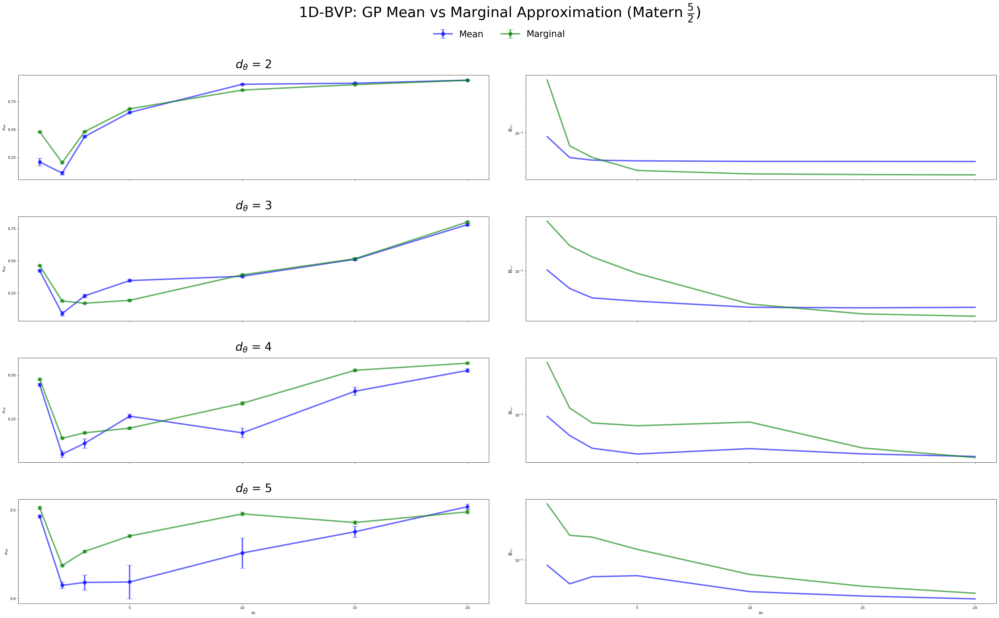

In [4]:
model_type = ["pigp"]
#Nts = [30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45]
Nts = [1,2,3,5,10,15,20]

KLs = [2, 3, 4, 5]

res_mean = {}
res_mean_ma = {}

res_mean = final_results("pigp",KLs,Nts,marginal_approximation=False,
                                                    kernel_spatial="Matern52",kernel_parameter ="Matern52")

res_mean_ma = final_results("pigp",KLs,Nts,marginal_approximation=True,
                                                    kernel_spatial="Matern52",kernel_parameter ="Matern52")


fig, axs = plt.subplots(len(KLs),2, figsize=(40, 25), sharex=True)
fig.suptitle("1D-BVP: GP Mean vs Marginal Approximation (Matern $\\frac{{5}}{{2}}$)", fontsize = 40)
plt.rcParams.update({'font.size': 50})

for i,k in enumerate(KLs):
    axs[i, 0].set_title(f"$d_{{\\theta}}$ = {k}", fontsize=32, pad=20)

    # Example usage:
    mean, std = np.array(res_mean["alpha"][str(k)]).T
    axs[i,0].errorbar(Nts, mean, yerr=std, fmt="o-", capsize=8, label=f"Mean",color="blue",linewidth=4,markersize=10, alpha=0.6)
    
    mean, std = np.array(res_mean_ma["alpha"][str(k)]).T
    axs[i,0].errorbar(Nts, mean, yerr=std, fmt="o-", capsize=8, label=f"Marginal",color="green",linewidth=4,markersize=10, alpha=0.6)

    #axs[i,0].set_ylim((0,1))
    axs[i,0].set_ylabel("$\\alpha_{{val}}$")

    mean, std = np.array(res_mean["m_error"][str(k)]).T
    axs[i,1].semilogy(Nts, mean,label=f"Mean",color="blue",linewidth=4,markersize=10, alpha=0.6)
    
    mean, std = np.array(res_mean_ma["m_error"][str(k)]).T
    axs[i,1].semilogy(Nts, mean,label=f"Marginal", color="green",linewidth=4,markersize=10, alpha=0.6)
    axs[i,1].set_ylabel("$\\| \\|_{L_{\\mu^{y,F}}}$")


axs[-1,0].set_xlabel("$N_{{T}}$"), axs[-1,1].set_xlabel("$N_{{T}}$")

plt.tight_layout(rect=[0, 0, 1, 0.985])  # leave space for both title and legend

# --- ADD HORIZONTAL LEGEND ON TOP ---
handles, labels = axs[0, 0].get_legend_handles_labels()
fig.legend(handles, labels,loc="upper center", ncol=2, fontsize=25, frameon=False, bbox_to_anchor=(0.5, 0.95))

# DGaLA

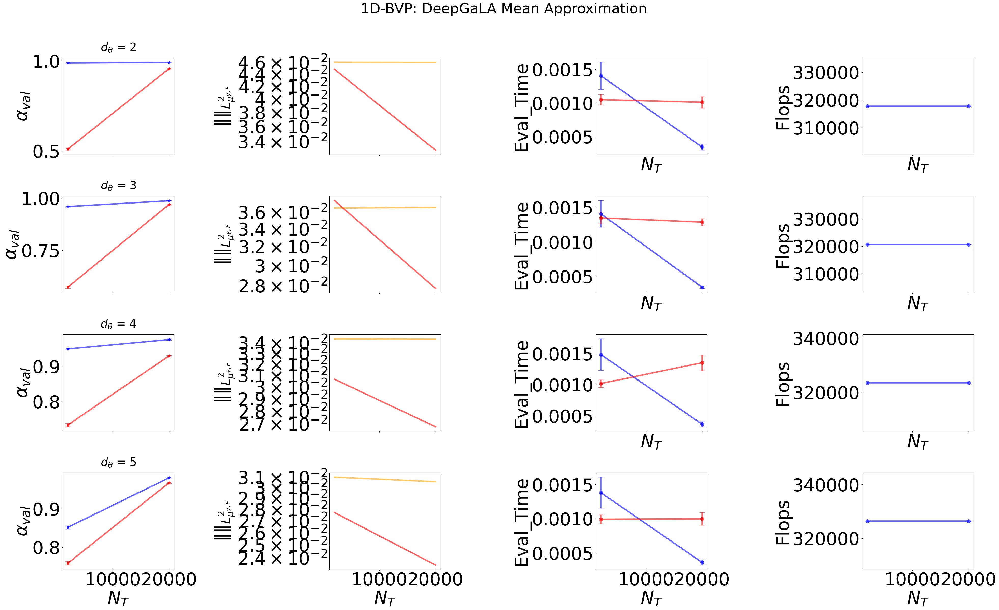

In [9]:
Ns = [2000, 20000,]
BATCHES = [100, 150, 200, 250, 400]
KLs = [2,3,4,5]

batch =200

results = final_results(model_type="dgala2",KLs=KLs,Nts=Ns,batch_size=batch,hidden_dim=80,num_layers=2,marginal_approximation=False)
results_mag = final_results(model_type="dgala2",KLs=KLs,Nts=Ns,batch_size=batch,hidden_dim=80,num_layers=2,marginal_approximation=True)

fig, axs = plt.subplots(len(KLs),4, figsize=(40, 25), sharex=True)
fig.suptitle("1D-BVP: DeepGaLA Mean Approximation", fontsize = 40)
plt.rcParams.update({'font.size': 50})

for i,k in enumerate(KLs):
    axs[i, 0].set_title(f"$d_{{\\theta}}$ = {k}", fontsize=32, pad=20)

    # Example usage:
    mean, std = np.array(results["alpha"][str(k)]).T
    axs[i,0].errorbar(Ns, mean, yerr=std, fmt="*-", capsize=8, label=f"Mean", color="blue",linewidth=4,markersize=10,alpha=0.6)
    #axs[i,0].set_ylim((0,1))
    axs[i,0].set_ylabel("$\\alpha_{{val}}$")

    mean, std = np.array(results["m_error"][str(k)]).T
    axs[i,1].semilogy(Ns, mean,label=f"Mean", color="orange",linewidth=4,markersize=10, alpha=0.6)
    axs[i,1].set_ylabel("$\\| \\|_{L_{\\mu^{y,F}}^{2}}$")

    mean, std = np.array(results["total_cpu_time"][str(k)]).T
    axs[i,2].errorbar(Ns, mean,yerr=std, fmt="o-", capsize=8, label=f"Mean",color="blue",linewidth=4,markersize=10, alpha=0.6)
    axs[i,2].set_xlabel("$N_{{T}}$")
    axs[i,2].set_ylabel("Eval_Time")


    # Example usage:
    mean, std = np.array(results_mag["alpha"][str(k)]).T
    axs[i,0].errorbar(Ns, mean, yerr=std, fmt="*-", capsize=8, label=f"Marginal$", color="red",linewidth=4,markersize=10,alpha=0.6)
    #axs[i,0].set_ylim((0,1))
    axs[i,0].set_ylabel("$\\alpha_{{val}}$")

    mean, std = np.array(results_mag["m_error"][str(k)]).T
    axs[i,1].semilogy(Ns, mean,label=f"Marginal", color="red",linewidth=4,markersize=10, alpha=0.6)
    axs[i,1].set_ylabel("$\\| \\|_{L_{\\mu^{y,F}}^{2}}$")

    mean, std = np.array(results_mag["total_cpu_time"][str(k)]).T
    axs[i,2].errorbar(Ns, mean,yerr=std, fmt="o-", capsize=8, label=f"Marginal",color="red",linewidth=4,markersize=10, alpha=0.6)
    axs[i,2].set_xlabel("$N_{{T}}$")
    axs[i,2].set_ylabel("Eval_Time")
    mean, std = np.array(results["total_flops"][str(k)]).T
    axs[i,3].errorbar(Ns, mean,yerr=std, fmt="o-", capsize=8, label=f"SE",color="blue",linewidth=4,markersize=10, alpha=0.6)
    axs[i,3].set_xlabel("$N_{{T}}$")
    axs[i,3].set_ylabel("Flops")

axs[-1,0].set_xlabel("$N_{{T}}$"), axs[-1,1].set_xlabel("$N_{{T}}$")

plt.tight_layout(rect=[0, 0, 1, 1])  # leave space for both title and legend

# --- ADD HORIZONTAL LEGEND ON TOP ---
#handles, labels = axs[0, 0].get_legend_handles_labels()
#fig.legend(handles, labels,loc="upper center", ncol=2, fontsize=25, frameon=False, bbox_to_anchor=(0.5, 0.95))
#plt.savefig(f"./results/images/bvp1d_nn_mean_convergence.jpg", bbox_inches='tight') 

In [10]:
k = str(5)  # whatever k is, ensure it's a string

data = {"alpha": results["alpha"][k],"m_error": results["m_error"][k],
        "time": results["total_cpu_time"][k], "time_GPU": results["total_cuda_time"][k]}
df = pd.DataFrame(data)
df = df.set_index(pd.Index(Ns))
print(df)

                                             alpha  \
2000    (0.8518500089645386, 0.004265502309558524)   
20000  (0.9805599987506867, 0.0018139451362089913)   

                                            m_error  \
2000   (0.03098677475421141, 5.485747980385536e-05)   
20000  (0.03054125629647768, 5.731387117099751e-05)   

                                                time  \
2000   (0.001381168916891689, 0.0002262572880726223)   
20000   (0.000362993099309931, 3.78544442341988e-05)   

                                               time_GPU  
2000   (0.00019768780000000002, 3.1974257082847155e-06)  
20000                                        (0.0, 0.0)  


In [11]:
k = str(2)  # whatever k is, ensure it's a string

data = {"alpha": results_mag["alpha"][k],"m_error": results_mag["m_error"][k],
        "time": results_mag["total_cpu_time"][k]}
df = pd.DataFrame(data)
df = df.set_index(pd.Index(Ns))
print(df)

                                             alpha  \
2000    (0.5106000065803528, 0.005720316219306864)   
20000  (0.9568499982357025, 0.0011002405238615025)   

                                              m_error  \
2000   (0.044767368467828826, 5.7738766374892524e-05)   
20000   (0.032883172194394655, 7.202134802200226e-05)   

                                                 time  
2000   (0.0010491874187418743, 7.788816042429812e-05)  
20000  (0.0010112911291129112, 8.625218777691881e-05)  


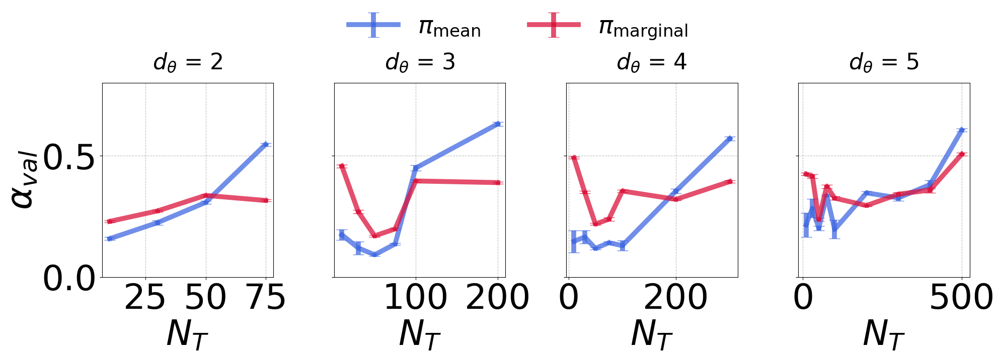

In [5]:
Ns = [10,30,50,75, 100,200, 300, 400, 500, 1000]
BATCHES = [100, 100, 100, 100]
KLs = [2,3,4,5]

fig, axs = plt.subplots(1,len(KLs), figsize=(20, 8),sharey="row", sharex="col")
#fig.suptitle("Elliptic 2D: DeepGaLA-Low Data Regime", fontsize = 40)
plt.rcParams.update({'font.size': 35})

batch = 200
for i,k in enumerate(KLs):
    if k==2:
        n = -6
    elif k==3:
        n=-4
    elif k==4:
        n=-3
    else:
        n =-1
    results = final_results(model_type="dgala2",KLs=[k],Nts=Ns[:n],batch_size=batch,hidden_dim=80,num_layers=2,marginal_approximation=False)
    results_mag = final_results(model_type="dgala2",KLs=[k],Nts=Ns[:n],batch_size=batch,hidden_dim=80,num_layers=2,marginal_approximation=True)

    axs[i].set_title(f"$d_{{\\theta}}$ = {k}", fontsize=32, pad=20)

    # Example usage:
    mean, std = np.array(results["alpha"][str(k)]).T
    axs[i].errorbar(Ns[:n], mean, yerr=std, fmt="*-", capsize=8, label="$\pi_{\\text{mean}}$",linewidth=7,markersize=8,alpha=0.75,color="royalblue")
    axs[i].set_ylim((0,.8))

    # mean, std = np.array(results["m_error"][str(k)]).T
    # axs[1,i].semilogy(Ns[:n], mean,label=rf"$\| \mathcal{{G}}_{{X}}^{{F}} -  m_{{S,N}}^{{\mathcal{{G}}}} \|_{{L_{{\mu^{{y,F}}}}^{{2}}}}$",linewidth=7,markersize=10, alpha=0.75,color="royalblue")

    mean, std = np.array(results_mag["alpha"][str(k)]).T
    axs[i].errorbar(Ns[:n], mean, yerr=std, fmt="*-", capsize=8, label="$\pi_{\\text{marginal}}$",linewidth=7,markersize=8, alpha=0.75,color="crimson")
    #axs[0,i].set_ylim((0,.2))
    #axs[0,i].set_ylabel("$\\alpha_{{val}}$")

    # mean, std = np.array(results_mag["m_error"][str(k)]).T
    # axs[1,i].semilogy(Ns[:n], mean,label=rf"$\left\|  \mathbb{{E}}_{{\mu^{{S,N}}}}\left[ \| \mathcal{{G}}_{{X}}^{{F}} -  \mathcal{{G}}_{{X}}^{{S,N}}\|_{2}^{2}\right] ^{{1/2}} \right\|_{{L_{{\mu^{{y,F}}}}}}$",linewidth=7,markersize=8, alpha=0.75,color="crimson")
    # #axs[1,i].set_ylabel("$\\| \\|_{L_{\\mu^{y,F}}^{2}}$")

    axs[i].set_xlabel("$N_{{T}}$"), 
    #axs[-1,1].set_xlabel("$N_{{T}}$")
    axs[i].grid(True, linestyle='--', alpha=0.8)
    #axs[1,i].grid(True, linestyle='--', alpha=0.8)


    plt.tight_layout(rect=[0, 0, 1, 0.88])  # leave space for both title and legend
axs[0].set_ylabel("$\\alpha_{{val}}$")
#axs[1,0].set_ylabel("$\\| \cdot \\|$")

# --- ADD HORIZONTAL LEGEND ON TOP ---
handles, labels = axs[0].get_legend_handles_labels()
fig.legend(handles, labels,loc="upper center", ncol=2, fontsize=35, frameon=False, bbox_to_anchor=(0.5, 0.96))

# handles, labels = axs[1, 0].get_legend_handles_labels()
# fig.legend(handles, labels,loc="center", ncol=2, fontsize=35, frameon=False, bbox_to_anchor=(0.54, 0.48))

plt.savefig(f"./results/images/elliptic2d_dgala_low_data.pdf", bbox_inches='tight') 

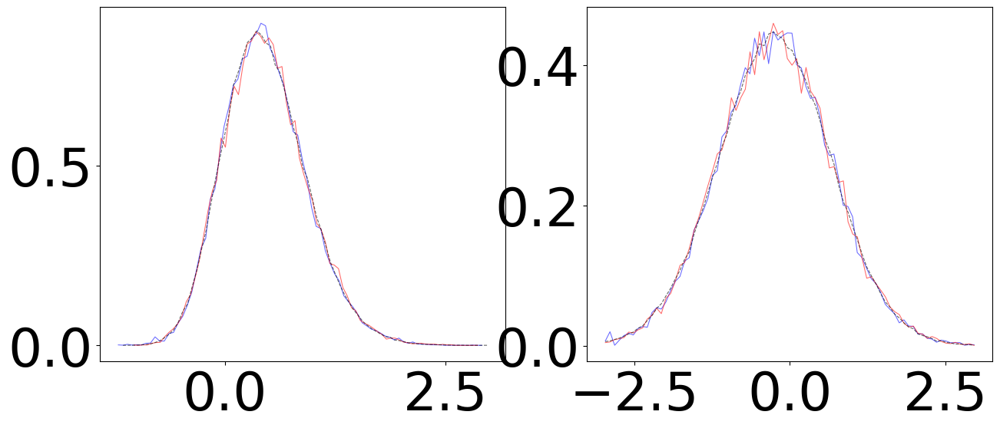

In [34]:
kl =2 
n = 20
bc = 10

fig, axs = plt.subplots(1, 2, figsize=(15, 6), sharex="col")

sample = np.load(f'./results/FEM2d_mcmc_kl{kl}_0.npy')
sampler = np.load(f'./results/dgala2d_da_chain_mean_hl3_hd50_s{n}_b{bc}_kl{kl}_0.npy')
sampler_mg = np.load(f'./results/dgala2d_da_chain_marginal_hl3_hd50_s{n}_b{bc}_kl{kl}_0.npy')

for j in range(kl):
        bin_centers, counts = histogram_(sampler[:, j], bins=80)
        axs[j].plot(bin_centers, counts, alpha=0.6, linestyle="-", linewidth=0.75,
                    color="blue", label=f"mean" if j == 0 else None)  # Label only once per N
        
        bin_centers, counts = histogram_(sampler_mg[:, j], bins=80)
        axs[j].plot(bin_centers, counts, alpha=0.6, linestyle="-", linewidth=0.75,
                    color="red", label=f"marginal" if j == 0 else None)  # Label only once per N
        
        
        bin_centers, counts = histogram_(sample[:, j],bins=80)
        axs[j].plot(bin_centers, counts, alpha=0.6, linestyle="--", linewidth=0.8, label = r"$\pi_{\text{FEM}}$",color = "black")


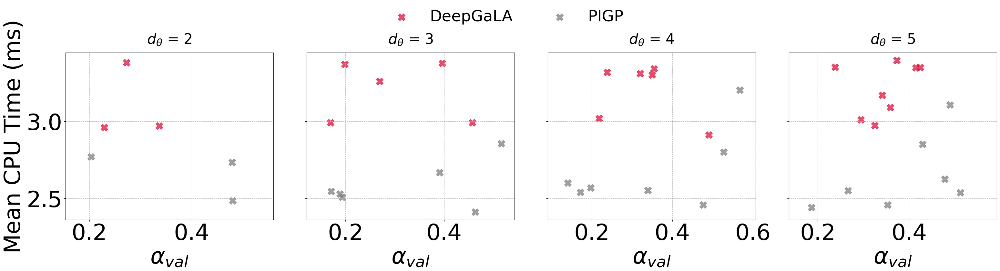

In [7]:
Ns = [10,30,50,75, 100,200, 300, 400, 500]
KLs = [2,3,4,5]

fig, axs = plt.subplots(1,len(KLs), figsize=(32, 10),sharey="row", sharex="col")
#fig.suptitle("Elliptic 2D: Marginal Likelihood Evaluation time (Low Data Regime) ", fontsize = 40)
plt.rcParams.update({'font.size': 50})

batch = 200
for i,k in enumerate(KLs):
    if k==2:
        n = -6
    elif k==3:
        n=-4
    elif k==4:
        n=-3
    else:
        n =-1
    results = final_results(model_type="dgala2",KLs=[k],Nts=Ns[:n],batch_size=batch,hidden_dim=80,num_layers=2,marginal_approximation=False)
    results_mag = final_results(model_type="dgala2",KLs=[k],Nts=Ns[:n],batch_size=batch,hidden_dim=80,num_layers=2,marginal_approximation=True)

    mean_mag_time, std = np.array(results_mag["total_cpu_time"][str(k)]).T
    mean_error, std = np.array(results_mag["alpha"][str(k)]).T

    mean_mag_time_gp, std = np.array(res_mean_ma["total_cpu_time"][str(k)]).T
    mean_mag_error_gp, std = np.array(res_mean_ma["alpha"][str(k)]).T

    if k==2:
        z = -4
    elif k==3:
        z=-3
    elif k==4:
        z=-1
    else:
        z =-1

    axs[i].set_title(f"$d_{{\\theta}}$ = {k}", fontsize=32, pad=20)


    axs[i].scatter(mean_error, mean_mag_time*1000,label=f"DeepGaLA", s=250,marker="X", alpha=0.75,color="crimson") 
    axs[i].scatter(mean_mag_error_gp, mean_mag_time_gp*1000,label=f"PIGP", s=250,marker="X", alpha=0.75,color="gray")

    axs[i].set_xlim(np.min(mean_mag_error_gp[:z])-0.05,np.max(mean_mag_error_gp[:z]) +0.08)
    axs[i].set_xlabel("$\\alpha_{{val}}$")

    axs[i].grid(True, linestyle='--', alpha=0.8)


plt.tight_layout(rect=[0, 0, 1, 0.88])  # leave space for both title and legend
axs[0].set_ylabel("Mean CPU Time (ms)")

# --- ADD HORIZONTAL LEGEND ON TOP ---
handles, labels = axs[0].get_legend_handles_labels()
fig.legend(handles, labels,loc="upper center", ncol=2, fontsize=35, frameon=False, bbox_to_anchor=(0.5, 0.92))
plt.savefig(f"./results/images/elliptic2d_eval_time_low_data.pdf", bbox_inches='tight') 

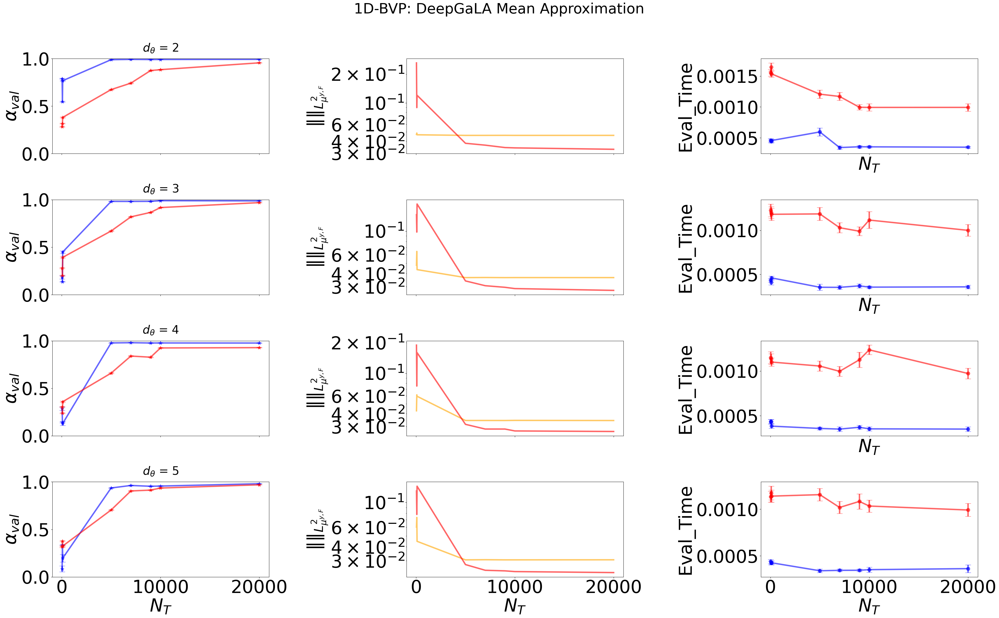

In [64]:
Ns = [ 40, 75, 100,5000,7000,9000,10000,20000]

KLs = [2,3,4,5]

batch =200

results = final_results(model_type="dgala2",KLs=KLs,Nts=Ns,batch_size=batch,hidden_dim=80,num_layers=2,marginal_approximation=False)
results_mag = final_results(model_type="dgala2",KLs=KLs,Nts=Ns,batch_size=batch,hidden_dim=80,num_layers=2,marginal_approximation=True)

fig, axs = plt.subplots(len(KLs),3, figsize=(40, 25), sharex=True)
fig.suptitle("1D-BVP: DeepGaLA Mean Approximation", fontsize = 40)
plt.rcParams.update({'font.size': 50})

for i,k in enumerate(KLs):
    axs[i, 0].set_title(f"$d_{{\\theta}}$ = {k}", fontsize=32, pad=20)

    # Example usage:
    mean, std = np.array(results["alpha"][str(k)]).T
    axs[i,0].errorbar(Ns, mean, yerr=std, fmt="*-", capsize=8, label=f"Mean", color="blue",linewidth=4,markersize=10,alpha=0.6)
    axs[i,0].set_ylim((0,1))
    axs[i,0].set_ylabel("$\\alpha_{{val}}$")

    mean, std = np.array(results["m_error"][str(k)]).T
    axs[i,1].semilogy(Ns, mean,label=f"Mean", color="orange",linewidth=4,markersize=10, alpha=0.6)
    axs[i,1].set_ylabel("$\\| \\|_{L_{\\mu^{y,F}}^{2}}$")

    mean, std = np.array(results["total_cpu_time"][str(k)]).T
    axs[i,2].errorbar(Ns, mean,yerr=std, fmt="o-", capsize=8, label=f"Mean",color="blue",linewidth=4,markersize=10, alpha=0.6)
    axs[i,2].set_xlabel("$N_{{T}}$")
    axs[i,2].set_ylabel("Eval_Time")


    # Example usage:
    mean, std = np.array(results_mag["alpha"][str(k)]).T
    axs[i,0].errorbar(Ns, mean, yerr=std, fmt="*-", capsize=8, label=f"Marginal$", color="red",linewidth=4,markersize=10,alpha=0.6)
    axs[i,0].set_ylim((0,1))
    axs[i,0].set_ylabel("$\\alpha_{{val}}$")

    mean, std = np.array(results_mag["m_error"][str(k)]).T
    axs[i,1].semilogy(Ns, mean,label=f"Marginal", color="red",linewidth=4,markersize=10, alpha=0.6)
    axs[i,1].set_ylabel("$\\| \\|_{L_{\\mu^{y,F}}^{2}}$")

    mean, std = np.array(results_mag["total_cpu_time"][str(k)]).T
    axs[i,2].errorbar(Ns, mean,yerr=std, fmt="o-", capsize=8, label=f"Marginal",color="red",linewidth=4,markersize=10, alpha=0.6)
    axs[i,2].set_xlabel("$N_{{T}}$")
    axs[i,2].set_ylabel("Eval_Time")
    # mean, std = np.array(results["total_flops"][str(k)]).T
    # axs[i,3].errorbar(Ns, mean,yerr=std, fmt="o-", capsize=8, label=f"SE",color="blue",linewidth=4,markersize=10, alpha=0.6)
    # axs[i,3].set_xlabel("$N_{{T}}$")
    # axs[i,3].set_ylabel("Flops")

axs[-1,0].set_xlabel("$N_{{T}}$"), axs[-1,1].set_xlabel("$N_{{T}}$")

plt.tight_layout(rect=[0, 0, 1, 1])  # leave space for both title and legend

# --- ADD HORIZONTAL LEGEND ON TOP ---
#handles, labels = axs[0, 0].get_legend_handles_labels()
#fig.legend(handles, labels,loc="upper center", ncol=2, fontsize=25, frameon=False, bbox_to_anchor=(0.5, 0.95))
#plt.savefig(f"./results/images/bvp1d_nn_mean_convergence.jpg", bbox_inches='tight') 

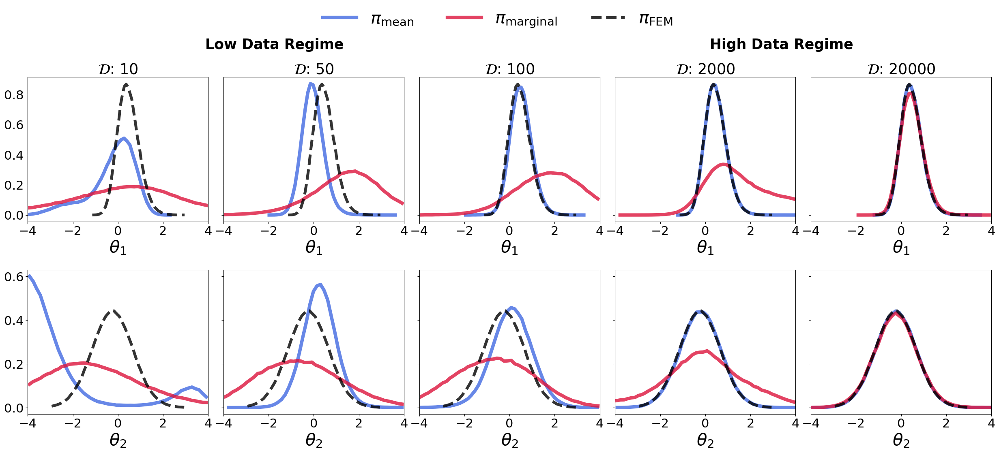

In [11]:
vr = 1e-4
theta_th = np.array([0.098, 0.430, 0.206, 0.090, -0.153, 0.292])

Nl = [10,50]
Nh = [100,2000, 20000]
N = Nl + Nh
batches = [10]*len(Nl) + [200]*len(Nh)
bins = 50
kl = 2
nn = 80

fig, axs = plt.subplots(2,len(N), figsize=(25, 12), sharex="row",sharey="row")
#fig.suptitle(f"Posterior Distributions")
plt.rcParams.update({'font.size': 22})
ylims = []

# --- Add subtitles for column groups ---
fig.text(0.28, 0.85, 'Low Data Regime', ha='center', fontsize=25,fontweight='bold')   # center above columns 1-2
fig.text(0.78, 0.85, 'High Data Regime', ha='center', fontsize=25,fontweight='bold')  # center above columns 3-4


for i,(nobs,batch) in  enumerate(zip(N,batches)):

    sample = np.load(f'./results/dgala2d_mcmc_mean_hl{2}_hd{nn}_s{nobs}_b{batch}_kl{kl}_0.npy')

    bin_centers, counts = histogram_(sample[:, 0],bins=bins)
    axs[0,i].plot(bin_centers, counts, alpha=0.8, linestyle="-", linewidth=6, label = r"$\pi_{\text{mean}}$",color = "royalblue")
    bin_centers, counts = histogram_(sample[:, 1],bins=bins)
    axs[1,i].plot(bin_centers, counts, alpha=0.8, linestyle="-", linewidth=6, label = r"$\pi_{\text{mean}}$",color = "royalblue")
    
    sample = np.load(f'./results/dgala2d_mcmc_marginal_hl{2}_hd{nn}_s{nobs}_b{batch}_kl{kl}_0.npy')

    bin_centers, counts = histogram_(sample[:, 0],bins=bins)
    axs[0,i].plot(bin_centers, counts, alpha=0.8, linestyle="-", linewidth=6, label =r"$\pi_{\text{marginal}}$",color = "crimson")
    bin_centers, counts = histogram_(sample[:, 1],bins=bins)
    axs[1,i].plot(bin_centers, counts, alpha=0.8, linestyle="-", linewidth=6, label = r"$\pi_{\text{marginal}}$",color = "crimson")
    
    sample = np.load(f'./results/FEM2d_mcmc_kl{kl}_0.npy')

    bin_centers, counts = histogram_(sample[:, 0],bins=bins)
    axs[0,i].plot(bin_centers, counts, alpha=0.8, linestyle="--", linewidth=5, label = r"$\pi_{\text{FEM}}$",color = "black")
    bin_centers, counts = histogram_(sample[:, 1],bins=bins)
    axs[1,i].plot(bin_centers, counts, alpha=0.8, linestyle="--", linewidth=5, label = r"$\pi_{\text{FEM}}$",color = "black")
    
    axs[0,i].set_xlabel("$\\theta_{1}$",color="black",fontsize = 30),axs[1,i].set_xlabel("$\\theta_{2}$",color="black",fontsize = 30)
    axs[0,i].set_title(f"$\mathcal{{D}}$: {nobs}", color ="black")

    axs[0,i].set_xlim((-4,4))
    axs[1,i].set_xlim((-4,4))

    
    axs[0,i].tick_params(axis='both', labelsize=22)
    axs[1,i].tick_params(axis='both', labelsize=22)

plt.tight_layout(rect=[0, 0, 1, 0.85])  # leave space for both title and legend

# --- ADD HORIZONTAL LEGEND ON TOP ---
handles, labels = axs[0, 0].get_legend_handles_labels()
fig.legend(handles, labels,loc="upper center", ncol=3, fontsize=30, frameon=False, bbox_to_anchor=(0.5, 0.96))
plt.savefig(f"./results/images/elliptic2d_pd_kl{kl}_{vr}.pdf", bbox_inches='tight') 

In [57]:
sample = np.load(f'./results/dgala2d_mcmc_mean_hl{3}_hd{60}_s{10}_b{10}_kl{2}_0.npy')
sample

array([[-2.5169117,  2.833295 ],
       [-2.5169117,  2.833295 ],
       [-2.5169117,  2.833295 ],
       ...,
       [-2.1625016,  1.8144997],
       [-2.1625016,  1.8144997],
       [-2.041848 ,  1.1099651]], dtype=float32)

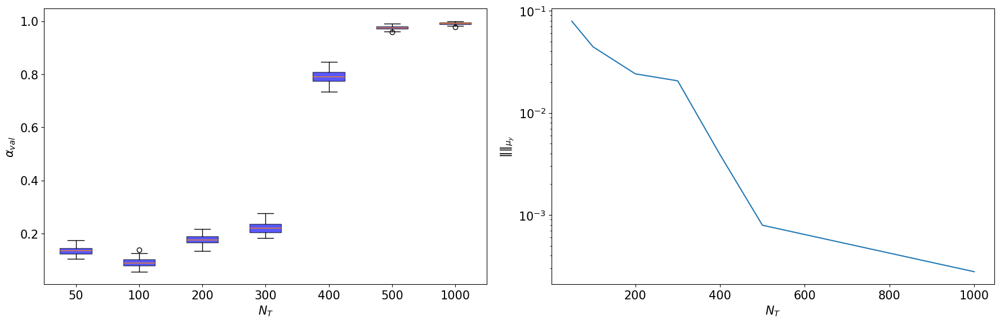

In [24]:
N = [50,100,200,300,400,500,1000]
batches = [10,10,10,10,10,250,250]
hd = [150]*len(N)
KLs = [2]*len(N)

results_experiment_mean,results_experiment_std = final_results(model_type="dgala",KLs=KLs,Nts=N,batch_size=batches,hidden_dim=hd,num_layers=3)
    

acceptance_mean_list = np.array([stat_ar(np.load(f"./results/dgala2d_da_mcmc_mean_hl3_hd150_s{n}_b{bth}_kl{kl}_0.npy"),every=500)[-1] for n,bth in zip(N,batches)])
cl = ["red", "blue", "green", "orange", "black","orange","tomato"]

fig, axs = plt.subplots(1, 2, figsize=(18, 6), sharex="col")
plt.rcParams.update({'font.size': 15})

bplot = axs[0].boxplot(acceptance_mean_list.T,patch_artist=True, tick_labels=[str(n) for n in N])  # Transpose to plot along axis 1
#plt.suptitle(f"Acceptance Rate for different NN",color = "blue")
# fill with colors
for patch, color in zip(bplot['boxes'], cl):
    patch.set_facecolor("blue")
    patch.set_alpha(0.65)
    patch.set_linewidth(1)

# Customize the plot
axs[0].set_xlabel("$N_{{T}}$")
axs[0].set_ylabel("$\\alpha_{val}$")

axs[1].semilogy(N, results_experiment_mean["error"][str(kl)], label=f"KL={k}")
axs[1].set_xlabel("$N_{{T}}$")
axs[1].set_ylabel("$\\| \\|_{\\mu_{{y}}}$")

# Save the plotx
plt.savefig(f"./results/images/elliptic_da_ar_kl{kl}_{vr}.pdf")
plt.tight_layout()
plt.show()

In [22]:
metrics = ["alpha", "m_error","N","total_cpu_time","total_flops"]
# Initialize dictionaries for mean and std
results_experiment = {m: {} for m in metrics}

results_marg_experiment = {m: {} for m in metrics}

N2 = [50,100,200,300,400,500,1000]
batches2 = [10,10,10,10,10,250,250]
hd2 = [150]*len(N2)

N3 = [100,200,300,600,1000,2000,3000]
batches3 = [10,10,10,10,100,100,100]
hd3 = [250]*len(N3)

N4 = [100,500,1000,2000,5000,6000]
batches4 = [10,100,100,100,100,100,100,100]
hd4 = [250]*len(N4)

N5 = [100,500,1000,5000,6000,7000]
batches5 = [10,100,200,200,200,200]
hd5 = [250]*len(N5)


parameters = {2:{"N":N2,"batch":batches2,"hd":hd2},
              3:{"N":N3,"batch":batches3,"hd":hd3},
              4:{"N":N4,"batch":batches4,"hd":hd4},
              5:{"N":N5,"batch":batches5,"hd":hd5}}

# N = [ 10,50,100,200,400,500,2000,3000]
# batches = [10,10,100,100,100,100,100,100,100,100]
# hd = [20]*len(N)
# KLs = [2]*len(N)

for k in parameters.keys():
    n = parameters[k]["N"]
    bc = parameters[k]["batch"]
    hd = parameters[k]["hd"]
    
    KLs = [k]*len(n)
    results = final_results(model_type="dgala",KLs=KLs,Nts=n,batch_size=bc,hidden_dim=hd,marginal_approximation=False,num_layers=3)
    results_marg = final_results(model_type="dgala",KLs=KLs,Nts=n,batch_size=bc,hidden_dim=hd,marginal_approximation=True,num_layers=3)

    results_experiment["alpha"][str(k)] = np.array(results["alpha"][str(k)])
    results_experiment["m_error"][str(k)] = np.array(results["m_error"][str(k)])
    results_experiment["total_cpu_time"][str(k)] = np.array(results["total_cpu_time"][str(k)])
    results_experiment["total_flops"][str(k)] = np.array(results["total_flops"][str(k)])
    results_experiment["N"][str(k)] = n

    results_marg_experiment["alpha"][str(k)] = np.array(results_marg["alpha"][str(k)])
    results_marg_experiment["m_error"][str(k)] = np.array(results_marg["m_error"][str(k)])
    results_marg_experiment["total_cpu_time"][str(k)] = np.array(results_marg["total_cpu_time"][str(k)])
    results_marg_experiment["total_flops"][str(k)] = np.array(results_marg["total_flops"][str(k)])
    results_marg_experiment["N"][str(k)] = n

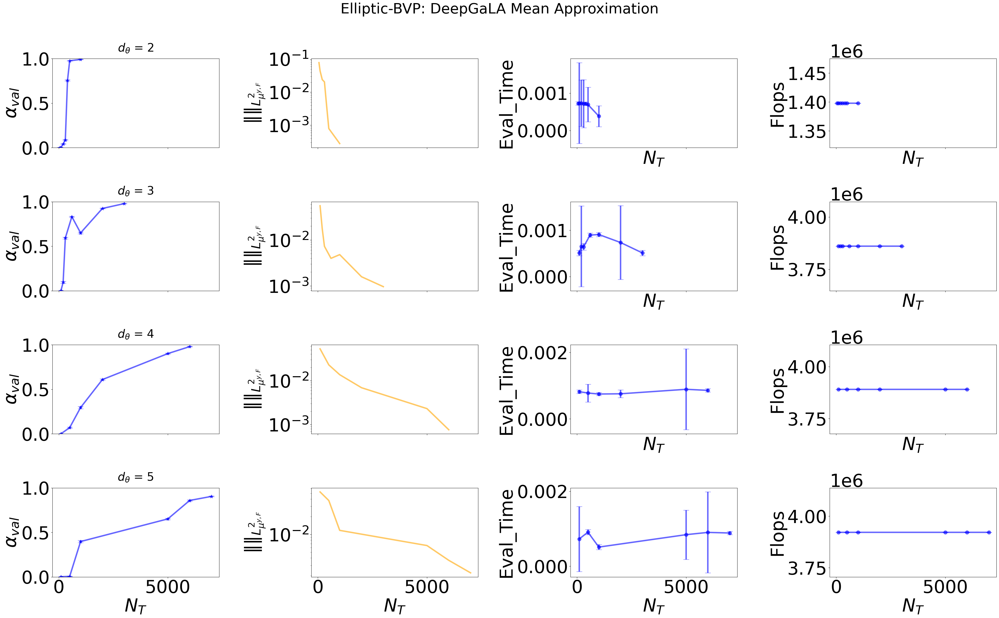

In [25]:
KLs = [2,3,4,5]

fig, axs = plt.subplots(len(KLs),4, figsize=(40, 25), sharex=True)
fig.suptitle("Elliptic-BVP: DeepGaLA Mean Approximation", fontsize = 40)
plt.rcParams.update({'font.size': 50})

for i,k in enumerate(KLs):
    axs[i, 0].set_title(f"$d_{{\\theta}}$ = {k}", fontsize=32, pad=20)

    # Example usage:
    mean, std = np.array(results_experiment["alpha"][str(k)]).T
    axs[i,0].errorbar(results_experiment["N"][str(k)], mean, yerr=std, fmt="*-", capsize=8, label=f"Matern $\\frac{{5}}{{2}}$", color="blue",linewidth=4,markersize=10,alpha=0.6)
    axs[i,0].set_ylim((0,1))
    axs[i,0].set_ylabel("$\\alpha_{{val}}$")

    mean, std = np.array(results_experiment["m_error"][str(k)]).T
    axs[i,1].semilogy(results_experiment["N"][str(k)], mean,label=f"Matern $\\frac{{5}}{{2}}$", color="orange",linewidth=4,markersize=10, alpha=0.6)
    axs[i,1].set_ylabel("$\\| \\|_{L_{\\mu^{y,F}}^{2}}$")

    mean, std = np.array(results_experiment["total_cpu_time"][str(k)]).T
    axs[i,2].errorbar(results_experiment["N"][str(k)], mean,yerr=std, fmt="o-", capsize=8, label=f"SE",color="blue",linewidth=4,markersize=10, alpha=0.6)
    axs[i,2].set_xlabel("$N_{{T}}$")
    axs[i,2].set_ylabel("Eval_Time")

    mean, std = np.array(results_experiment["total_flops"][str(k)]).T
    axs[i,3].errorbar(results_experiment["N"][str(k)], mean,yerr=std, fmt="o-", capsize=8, label=f"SE",color="blue",linewidth=4,markersize=10, alpha=0.6)
    axs[i,3].set_xlabel("$N_{{T}}$")
    axs[i,3].set_ylabel("Flops")

axs[-1,0].set_xlabel("$N_{{T}}$"), axs[-1,1].set_xlabel("$N_{{T}}$")

plt.tight_layout(rect=[0, 0, 1, 1])  # leave space for both title and legend

# --- ADD HORIZONTAL LEGEND ON TOP ---
#handles, labels = axs[0, 0].get_legend_handles_labels()
#fig.legend(handles, labels,loc="upper center", ncol=2, fontsize=25, frameon=False, bbox_to_anchor=(0.5, 0.95))
#plt.savefig(f"./results/images/elliptic_nn_mean_convergence.jpg", bbox_inches='tight') 


In [26]:
k = str(5)  # whatever k is, ensure it's a string

data = {"alpha": results_experiment["alpha"][k].tolist(),"m_error": results_experiment["m_error"][k].tolist(),
        "time": results_experiment["total_cpu_time"][k].tolist()}
df = pd.DataFrame(data)
df = df.set_index(pd.Index(N5))
print(df)

                                               alpha  \
100   [0.0018200000224169344, 0.0016011246299961525]   
500     [0.006040000030770898, 0.002792561597710895]   
1000       [0.3971599966287613, 0.01349304967294119]   
5000     [0.6515600025653839, 0.0076539096501996255]   
6000      [0.8586600005626679, 0.006698679095474413]   
7000      [0.9046000003814697, 0.004369900614872984]   

                                             m_error  \
100     [0.052653599666035784, 1.12601748357844e-05]   
500    [0.03765584533348733, 2.0309628026376375e-05]   
1000  [0.011736976156859763, 4.7128865912151205e-06]   
5000  [0.006490218335721605, 1.2429243882541662e-06]   
6000  [0.0036430849451282634, 3.987198819507151e-06]   
7000   [0.002233695276560431, 4.046381887989376e-06]   

                                                time  
100   [0.0007267695999999999, 0.0008685362280963528]  
500   [0.0009083673000000001, 6.929514550608867e-05]  
1000  [0.0005100708000000001, 6.679122537699095e-

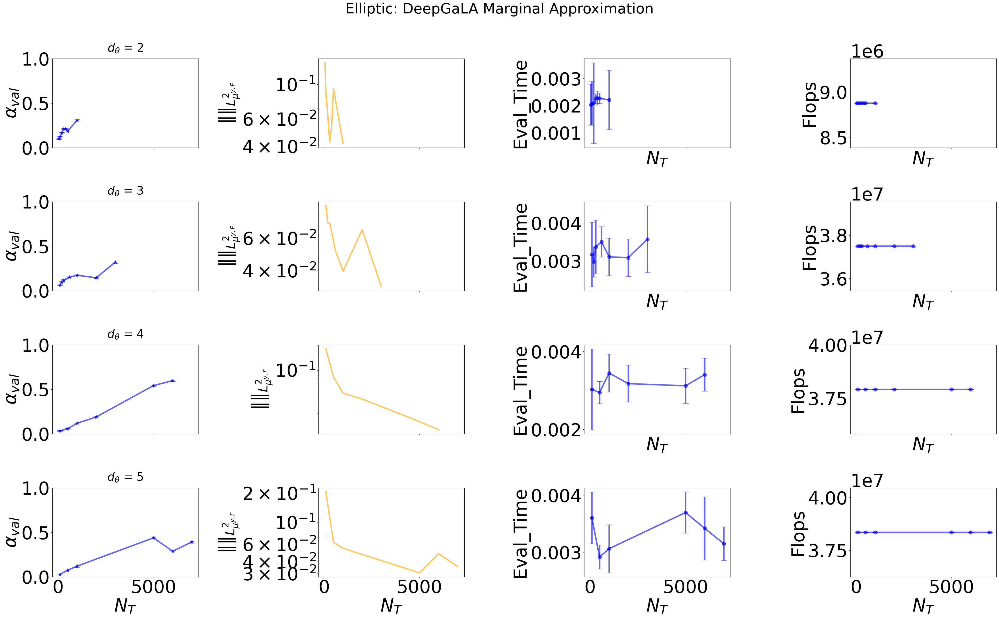

In [28]:
KLs = [2,3,4,5]

fig, axs = plt.subplots(len(KLs),4, figsize=(40, 25), sharex=True)
fig.suptitle("Elliptic: DeepGaLA Marginal Approximation", fontsize = 40)
plt.rcParams.update({'font.size': 50})

for i,k in enumerate(KLs):
    axs[i, 0].set_title(f"$d_{{\\theta}}$ = {k}", fontsize=32, pad=20)

    # Example usage:
    mean, std = np.array(results_marg_experiment["alpha"][str(k)]).T
    axs[i,0].errorbar(results_marg_experiment["N"][str(k)], mean, yerr=std, fmt="*-", capsize=8, label=f"Matern $\\frac{{5}}{{2}}$", color="blue",linewidth=4,markersize=10,alpha=0.6)
    axs[i,0].set_ylim((0,1))
    axs[i,0].set_ylabel("$\\alpha_{{val}}$")

    mean, std = np.array(results_marg_experiment["m_error"][str(k)]).T
    axs[i,1].semilogy(results_marg_experiment["N"][str(k)], mean,label=f"Matern $\\frac{{5}}{{2}}$", color="orange",linewidth=4,markersize=10, alpha=0.6)
    axs[i,1].set_ylabel("$\\| \\|_{L_{\\mu^{y,F}}^{2}}$")

    mean, std = np.array(results_marg_experiment["total_cpu_time"][str(k)]).T
    axs[i,2].errorbar(results_marg_experiment["N"][str(k)], mean,yerr=std, fmt="o-", capsize=8, label=f"SE",color="blue",linewidth=4,markersize=10, alpha=0.6)
    axs[i,2].set_xlabel("$N_{{T}}$")
    axs[i,2].set_ylabel("Eval_Time")

    mean, std = np.array(results_marg_experiment["total_flops"][str(k)]).T
    axs[i,3].errorbar(results_marg_experiment["N"][str(k)], mean,yerr=std, fmt="o-", capsize=8, label=f"SE",color="blue",linewidth=4,markersize=10, alpha=0.6)
    axs[i,3].set_xlabel("$N_{{T}}$")
    axs[i,3].set_ylabel("Flops")

axs[-1,0].set_xlabel("$N_{{T}}$"), axs[-1,1].set_xlabel("$N_{{T}}$")

plt.tight_layout(rect=[0, 0, 1, 1])  # leave space for both title and legend

# --- ADD HORIZONTAL LEGEND ON TOP ---
# handles, labels = axs[0, 0].get_legend_handles_labels()
# fig.legend(handles, labels,loc="upper center", ncol=2, fontsize=25, frameon=False, bbox_to_anchor=(0.5, 0.95))
#plt.savefig(f"./results/images/elliptic_nn_marginal_convergence.jpg", bbox_inches='tight') 

In [31]:
k = str(5)  # whatever k is, ensure it's a string

data = {"alpha": results_marg_experiment["alpha"][k].tolist(),"m_error": results_marg_experiment["m_error"][k].tolist(),
        "time": results_marg_experiment["total_cpu_time"][k].tolist()}
df = pd.DataFrame(data)
df = df.set_index(pd.Index(N5))
print(df)

                                             alpha  \
100   [0.028079999797046184, 0.007106729226155934]   
500    [0.07497999966144561, 0.005952109450169692]   
1000   [0.12104000002145768, 0.013829764478061484]   
5000   [0.43871999680995943, 0.011360703063085151]   
6000  [0.28812000453472136, 0.0062220217023290425]   
7000    [0.3926199972629547, 0.013212558061170367]   

                                             m_error  \
100      [0.2061351859725167, 8.392382031461657e-05]   
500    [0.062381324959097983, 1.837300811892531e-05]   
1000  [0.054241135500332334, 1.9794004918492917e-05]   
5000   [0.03033659746250231, 1.4098882495261673e-05]   
6000   [0.047659784707350765, 2.259804245935364e-05]   
7000    [0.03528737724791899, 9.452892599981846e-06]   

                                                time  
100            [0.0036027904, 0.0004532406242470328]  
500           [0.0029170702, 0.00021125105697240902]  
1000  [0.0030632706999999997, 0.0004238356658205041]  
5000  [0

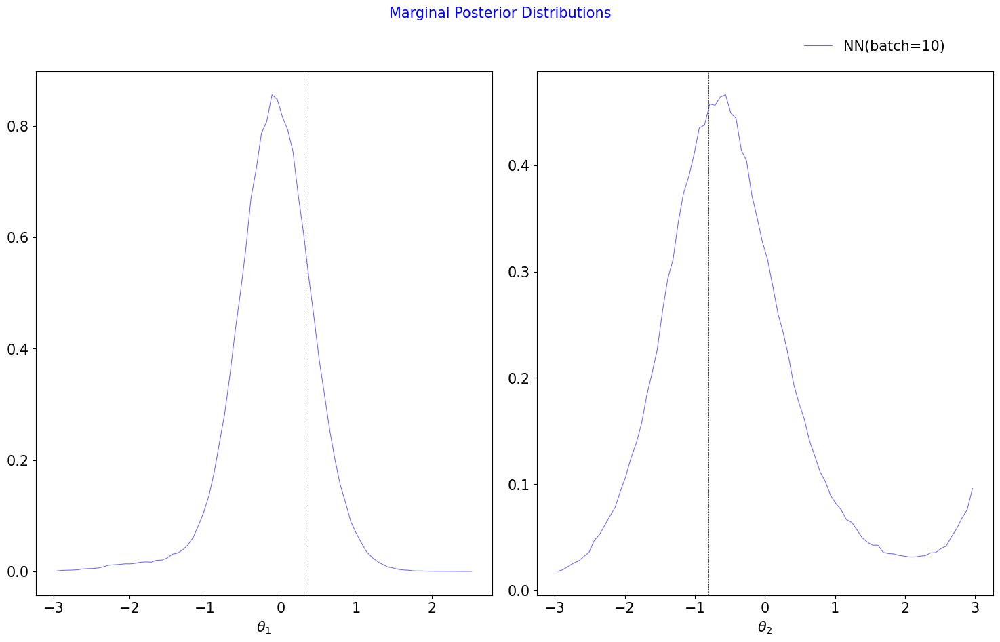

In [29]:
vr = 1e-4
_, _,theta_th = generate_noisy_obs(6, 20, seed=12345)

nobs = 30  # All N you want to plot
kl = [2]
bins = 80
#100 160 200 250 400 500
batches = [10]

colors = plt.cm.Dark2(np.linspace(0, 1, len(batches)))  # Color map for different N

fig, axs = plt.subplots(len(kl), max(kl), figsize=(15, 10), sharex="col")
fig.suptitle(f"Marginal Posterior Distributions", color="blue", fontsize =15)
plt.rcParams.update({'font.size': 15})

# Ensure axs is always 2D
if len(kl) == 1:
    axs = axs[np.newaxis, :]

for i, k in enumerate(kl):  # loop over kl rows
    for z,batch in enumerate(batches):
        try:
            sample_nn = np.load(f'./results/dgala2d_mcmc_mean_hl3_hd{100}_s{nobs}_b{batch}_kl{k}_0.npy')
            #sample_marg= np.load(f'./results/dgala2d_mcmc_marginal_hl3_hd{150}_s{nobs}_b{batch}_kl{k}_0.npy')

        except FileNotFoundError:
            print(f"Warning: file for N={nobs}, KL={k} not found.")
            continue  # skip if file is missing

        for j in range(k):  # only kl[i] subplots active
            bin_centers, counts = histogram_(sample_nn[:, j], bins=bins)
            axs[i, j].plot(bin_centers, counts, alpha=0.6, linestyle="-", linewidth=0.75,
                        color="blue", label=f"NN(batch={batch})" if j == 0 else None)  # Label only once per N
            axs[i, j].axvline(x=theta_th[j], color='black', linestyle="--", linewidth=0.5)

            # bin_centers, counts = histogram_(sample_marg[:, j], bins=bins)
            # axs[i, j].plot(bin_centers, counts, alpha=0.6, linestyle="-", linewidth=0.75,
            #             color="red", label=f"NN(batch={batch})" if j == 0 else None)  # Label only once per N


            # if z == 0 :

            #     sample = np.load(f'./results/FEM2d_mcmc_kl{k}_{0}.npy')

            #     bin_centers, counts = histogram_(sample[:, j],bins=bins)
            #     axs[i,j].plot(bin_centers, counts, alpha=0.6, linestyle="--", linewidth=0.8, label = r"$\pi_{\text{FEM}}$",color = "black")
        
            if i == len(kl) - 1:
                axs[i, j].set_xlabel(f"$\\theta_{j+1}$")

    # Hide unused subplots in each row
    for j in range(k, max(kl)):
        axs[i, j].axis('off')

# Add legend only once (you can also do per-plot legends if you prefer)
handles, labels = axs[0, 0].get_legend_handles_labels()
fig.legend(handles, labels, loc='upper right', bbox_to_anchor=(0.95, 0.95),frameon = False)

plt.tight_layout(rect=[0, 0.03, 1, 0.95])

plt.savefig(f"./results/images/elliptic2d_pd_kls_batches_var{vr}.pdf")


In [37]:
obs_points, sol_test,theta_th = generate_noisy_obs(obs=6,
                                              std=np.sqrt(1e-4),
                                              nparam=3,
                                              ncells=50,
                                              seed=12345)
theta_th

array([ 0.33447491, -0.80820413, -0.11632067])

Text(0, 0.5, '$\\| \\|_{\\mu_{{y}}}$')

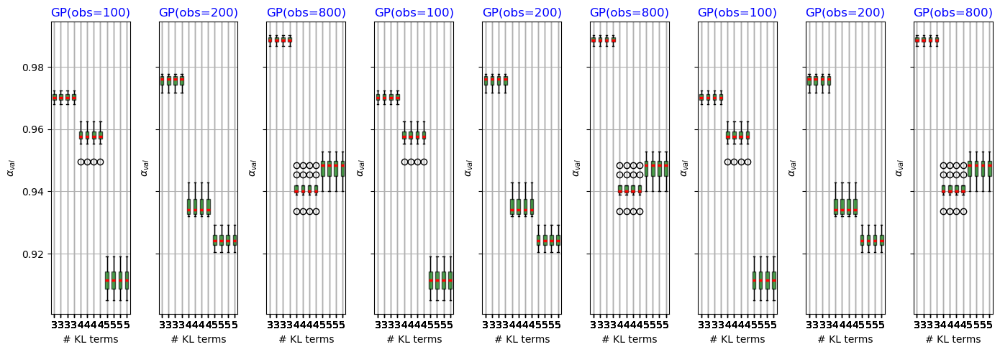

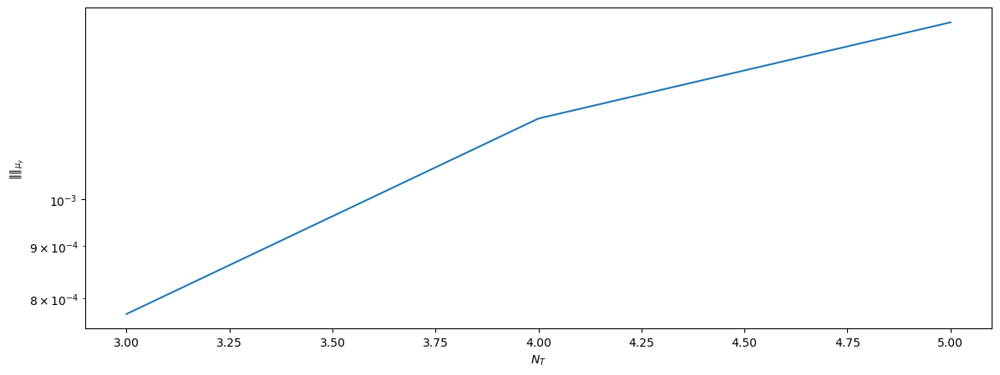

In [41]:
bins = 80
N = [5000]*3
batches = [100,200,800,100,200,800,100,200,800]
hd = [100]
KLs = [3,3,3,3,4,4,4,4,5,5,5,5]



# For each kl, collect acceptance means across N
acceptance_mean_list = []
m="mean"
for k in KLs:
    tmp = []
    for batch in batches:
        data = np.load(f"./results/dgala2d_da_mcmc_mean_hl3_hd{250}_s{10000}_b{batch}_kl{k}_0.npy")
        stat = stat_ar(data, every=5000)[-1]
        tmp.append(stat)
    acceptance_mean_list.append(tmp)

acceptance_mean_array = np.array(acceptance_mean_list)  # shape: (len(kl), len(N))

# Now plot
fig, ax = plt.subplots(1,len(batches),figsize=(14, 5), sharex=True, sharey=True)
plt.rcParams.update({'font.size': 10})

# Create boxplot
for i,n in enumerate(batches):
    bplot = ax[i].boxplot(acceptance_mean_array[:,i].T, patch_artist=True, tick_labels=[str(k) for k in KLs])

    # Fill each box with color (one color per kl)
    for patch in bplot['boxes']:
        patch.set_facecolor("green")
        patch.set_alpha(0.65)
        patch.set_linewidth(1)

    # Customize median lines
    for median in bplot['medians']:
        median.set_color('red')     # Black medians
        median.set_linewidth(2.5)      # Thicker line

    # Labeling
    ax[i].set_ylabel("$\\alpha_{val}$")
    ax[i].set_title(f"GP(obs={n})", color="blue")
    ax[i].grid(True)
    ax[i].set_xlabel("# KL terms")

plt.tight_layout()
#plt.savefig(f"./results/images/elliptic_da_ar_kls_gp{nn}_{vr}.pdf", bbox_inches='tight')

N = [10000]*3
batches = [100,200,800]
hd = [250]*3
KLs = [3,4,5]

results_experiment_mean,results_experiment_std = final_results(model_type="dgala",KLs=KLs,Nts=N,batch_size=batches,num_layers=3,hidden_dim=hd,marginal_approximation=False)
x = list(map(int, results_experiment_mean["error"].keys()))
y = [val[0] for val in results_experiment_mean["error"].values()]

fig, ax = plt.subplots(1,figsize=(14, 5), sharex=True, sharey=True)
plt.rcParams.update({'font.size': 10})

ax.semilogy(x, y, label=f"KL={k}")
ax.set_xlabel("$N_{{T}}$")
ax.set_ylabel("$\\| \\|_{\\mu_{{y}}}$")


In [53]:
N_ = [100,200,300,600,1000,2000,3000]
batches_ = [10,10,10,10,100,100,100]
for n,b in zip(N_,batches_):
    N = [n]
    batches = [b]
    hd = [250]*len(N)
    KLs = [3]

    results_experiment_mean,results_experiment_std = final_results(model_type="dgala",KLs=KLs,Nts=N,batch_size=batches,hidden_dim=hd,num_layers=3,marginal_approximation=False)
    print(results_experiment_mean)
    print("STD",results_experiment_std)

{'alpha_res': {'3': [0.10047333333333335]}, 'error': {'3': [0.05575959438908167]}, 'eval_time': {'3': [0.00042189793474972247]}}
STD {'alpha_res': {'3': [0.0010190627502214445]}, 'error': {'3': [1.1413081315282438e-05]}, 'eval_time': {'3': [1.670918031422252e-05]}}
{'alpha_res': {'3': [0.30158666666666667]}, 'error': {'3': [0.017400611443536353]}, 'eval_time': {'3': [0.0005367590337991714]}}
STD {'alpha_res': {'3': [0.002349146417081943]}, 'error': {'3': [2.2033883447655835e-05]}, 'eval_time': {'3': [1.3176032685806516e-05]}}
{'alpha_res': {'3': [0.6372599999999999]}, 'error': {'3': [0.007262286243199126]}, 'eval_time': {'3': [0.0005030550193041563]}}
STD {'alpha_res': {'3': [0.0021183641487399264]}, 'error': {'3': [1.0826876539298497e-05]}, 'eval_time': {'3': [2.2152238270475152e-05]}}
{'alpha_res': {'3': [0.8420866666666665]}, 'error': {'3': [0.0039673583628410695]}, 'eval_time': {'3': [0.00045447440003044905]}}
STD {'alpha_res': {'3': [0.0009204829650182815]}, 'error': {'3': [7.4114

In [54]:
N_ = [100,500,1000,2000,5000,6000]
batches_ = [10,100,100,100,100,100,100,100]
for n,b in zip(N_,batches_):
    N = [n]
    batches = [b]
    hd = [250]*len(N)
    KLs = [4]

    results_experiment_mean,results_experiment_std = final_results(model_type="dgala",KLs=KLs,Nts=N,batch_size=batches,hidden_dim=hd,num_layers=3,marginal_approximation=False)
    print(results_experiment_mean)
    print("STD",results_experiment_std)

{'alpha_res': {'4': [0.08832]}, 'error': {'4': [0.05269079208350097]}, 'eval_time': {'4': [0.0004163141641765833]}}
STD {'alpha_res': {'4': [0.0020679136023215904]}, 'error': {'4': [1.4957709121878795e-05]}, 'eval_time': {'4': [1.5089857346195334e-05]}}
{'alpha_res': {'4': [0.24631999999999998]}, 'error': {'4': [0.022786899893429]}, 'eval_time': {'4': [0.00048511581122875213]}}
STD {'alpha_res': {'4': [0.003774864235969284]}, 'error': {'4': [5.2954321869709015e-05]}, 'eval_time': {'4': [1.81127354800204e-05]}}
{'alpha_res': {'4': [0.4284866666666667]}, 'error': {'4': [0.013632475563726244]}, 'eval_time': {'4': [0.0004728916473686695]}}
STD {'alpha_res': {'4': [0.0019768212418481935]}, 'error': {'4': [2.0014682238034765e-05]}, 'eval_time': {'4': [1.4121721746423056e-05]}}
{'alpha_res': {'4': [0.6978]}, 'error': {'4': [0.006909065958416462]}, 'eval_time': {'4': [0.00042416467145085335]}}
STD {'alpha_res': {'4': [0.0015509996776273264]}, 'error': {'4': [2.401439343590817e-05]}, 'eval_time

In [49]:
N_ = [100,500,1000,5000,6000,7000]
batches_ = [10,100,200,200,200,200]
for n,b in zip(N_,batches_):
    N = [n]
    batches = [b]
    hd = [250]*len(N)
    KLs = [5]

    results_experiment_mean,results_experiment_std = final_results(model_type="dgala",KLs=KLs,Nts=N,batch_size=batches,hidden_dim=hd,num_layers=3,marginal_approximation=False)
    print(results_experiment_mean)
    print("STD",results_experiment_std)

{'alpha_res': {'5': [0.12634]}, 'error': {'5': [0.05260106448723378]}, 'eval_time': {'5': [0.0004494312200695276]}}
STD {'alpha_res': {'5': [0.003916835457355846]}, 'error': {'5': [4.286795434538547e-05]}, 'eval_time': {'5': [1.39387768667905e-05]}}
{'alpha_res': {'5': [0.16264666666666666]}, 'error': {'5': [0.03770958010229187]}, 'eval_time': {'5': [0.0004613552466034889]}}
STD {'alpha_res': {'5': [0.0029937416202619875]}, 'error': {'5': [6.012070999231281e-05]}, 'eval_time': {'5': [1.1202826426159655e-05]}}
{'alpha_res': {'5': [0.48644]}, 'error': {'5': [0.011760463024881393]}, 'eval_time': {'5': [0.0004643641952425241]}}
STD {'alpha_res': {'5': [0.004289180185847479]}, 'error': {'5': [1.996818733464049e-05]}, 'eval_time': {'5': [2.1591752686506117e-05]}}
{'alpha_res': {'5': [0.67464]}, 'error': {'5': [0.006507303042371379]}, 'eval_time': {'5': [0.0005399615131318569]}}
STD {'alpha_res': {'5': [0.0018022948334461312]}, 'error': {'5': [1.609348759580404e-05]}, 'eval_time': {'5': [1.36

In [45]:
N_ = [100,500,1000,2000,3000,5000,6000,7000,10000]
batches_ = [10,100,300,300,300,300,300,300,100]
for n,b in zip(N_,batches_):
    N = [n]
    batches = [b]
    hd = [250]*len(N)
    KLs = [5]

    results_experiment_mean,results_experiment_std = final_results(model_type="dgala",KLs=KLs,Nts=N,batch_size=batches,hidden_dim=hd,num_layers=3,marginal_approximation=False)
    print(results_experiment_mean)
    print("STD",results_experiment_std)

{'alpha_res': {'5': [0.12634]}, 'error': {'5': [0.05260106448723378]}, 'eval_time': {'5': [0.0004494312200695276]}}
STD {'alpha_res': {'5': [0.003916835457355846]}, 'error': {'5': [4.286795434538547e-05]}, 'eval_time': {'5': [1.39387768667905e-05]}}
{'alpha_res': {'5': [0.16264666666666666]}, 'error': {'5': [0.03770958010229187]}, 'eval_time': {'5': [0.0004613552466034889]}}
STD {'alpha_res': {'5': [0.0029937416202619875]}, 'error': {'5': [6.012070999231281e-05]}, 'eval_time': {'5': [1.1202826426159655e-05]}}
{'alpha_res': {'5': [0.7981400000000001]}, 'error': {'5': [0.005067526221922087]}, 'eval_time': {'5': [0.0004874762888066471]}}
STD {'alpha_res': {'5': [0.0017861690849412838]}, 'error': {'5': [1.3977017135033408e-05]}, 'eval_time': {'5': [1.3206525446013989e-05]}}
{'alpha_res': {'5': [0.5181933333333334]}, 'error': {'5': [0.011877127415617967]}, 'eval_time': {'5': [0.0004636447727680206]}}
STD {'alpha_res': {'5': [0.0017716533395547524]}, 'error': {'5': [4.186175690183619e-05]}, 

In [46]:
N_ = [100,500,1000,2000,3000,5000,6000,7000,10000]
batches_ = [10,100,400,400,400,400,400,400,100]
for n,b in zip(N_,batches_):
    N = [n]
    batches = [b]
    hd = [250]*len(N)
    KLs = [5]

    results_experiment_mean,results_experiment_std = final_results(model_type="dgala",KLs=KLs,Nts=N,batch_size=batches,hidden_dim=hd,num_layers=3,marginal_approximation=False)
    print(results_experiment_mean)
    print("STD",results_experiment_std)

{'alpha_res': {'5': [0.12634]}, 'error': {'5': [0.05260106448723378]}, 'eval_time': {'5': [0.0004494312200695276]}}
STD {'alpha_res': {'5': [0.003916835457355846]}, 'error': {'5': [4.286795434538547e-05]}, 'eval_time': {'5': [1.39387768667905e-05]}}
{'alpha_res': {'5': [0.16264666666666666]}, 'error': {'5': [0.03770958010229187]}, 'eval_time': {'5': [0.0004613552466034889]}}
STD {'alpha_res': {'5': [0.0029937416202619875]}, 'error': {'5': [6.012070999231281e-05]}, 'eval_time': {'5': [1.1202826426159655e-05]}}
{'alpha_res': {'5': [0.77768]}, 'error': {'5': [0.005247096500399409]}, 'eval_time': {'5': [0.000518685506656766]}}
STD {'alpha_res': {'5': [0.0012406449935416692]}, 'error': {'5': [1.8882766846526962e-05]}, 'eval_time': {'5': [1.3061811165248263e-05]}}
{'alpha_res': {'5': [0.8594066666666667]}, 'error': {'5': [0.0034749274697133624]}, 'eval_time': {'5': [0.0004870223510079086]}}
STD {'alpha_res': {'5': [0.0009042615157623828]}, 'error': {'5': [1.0313717008245795e-05]}, 'eval_time

In [47]:
N_ = [100,500,1000,2000,3000,5000,6000,7000,10000]
batches_ = [10,100,500,500,500,500,500,500,100]
for n,b in zip(N_,batches_):
    N = [n]
    batches = [b]
    hd = [250]*len(N)
    KLs = [5]

    results_experiment_mean,results_experiment_std = final_results(model_type="dgala",KLs=KLs,Nts=N,batch_size=batches,hidden_dim=hd,num_layers=3,marginal_approximation=False)
    print(results_experiment_mean)
    print("STD",results_experiment_std)

{'alpha_res': {'5': [0.12634]}, 'error': {'5': [0.05260106448723378]}, 'eval_time': {'5': [0.0004494312200695276]}}
STD {'alpha_res': {'5': [0.003916835457355846]}, 'error': {'5': [4.286795434538547e-05]}, 'eval_time': {'5': [1.39387768667905e-05]}}
{'alpha_res': {'5': [0.16264666666666666]}, 'error': {'5': [0.03770958010229187]}, 'eval_time': {'5': [0.0004613552466034889]}}
STD {'alpha_res': {'5': [0.0029937416202619875]}, 'error': {'5': [6.012070999231281e-05]}, 'eval_time': {'5': [1.1202826426159655e-05]}}
{'alpha_res': {'5': [0.7726000000000001]}, 'error': {'5': [0.004954653078784794]}, 'eval_time': {'5': [0.00046789472922682763]}}
STD {'alpha_res': {'5': [0.0037907606976260765]}, 'error': {'5': [1.1288219442692763e-05]}, 'eval_time': {'5': [1.539616072649841e-05]}}
{'alpha_res': {'5': [0.8988733333333334]}, 'error': {'5': [0.0024104719976906865]}, 'eval_time': {'5': [0.00047155066020786765]}}
STD {'alpha_res': {'5': [0.0025692714055847612]}, 'error': {'5': [9.368333378311263e-07]}

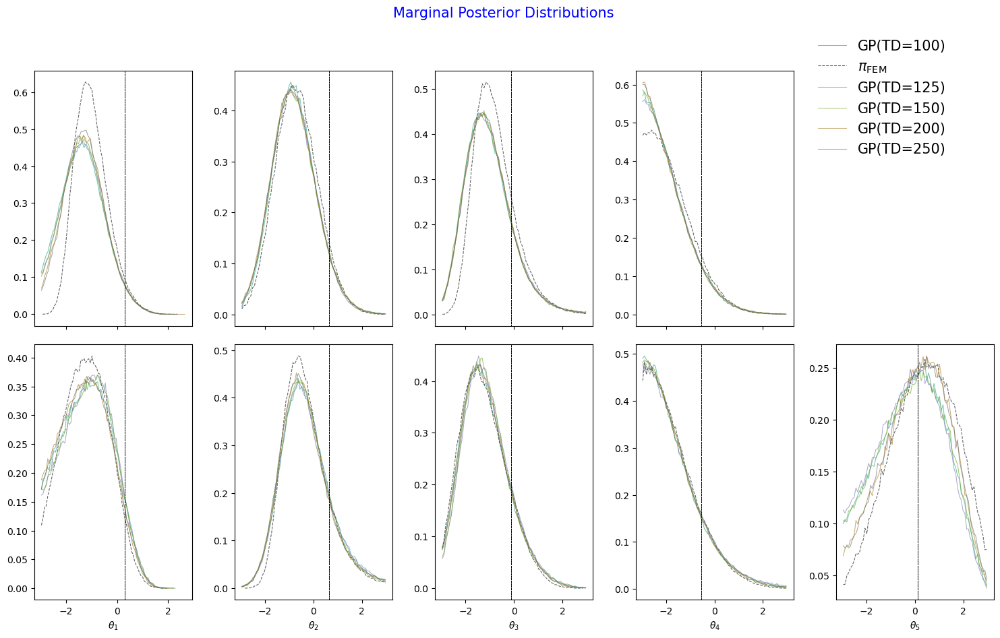

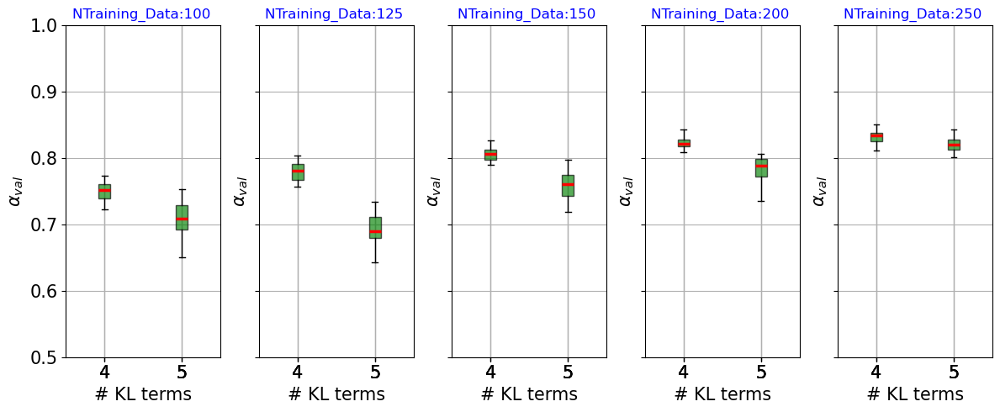

In [ ]:
vr = 1e-4
_, _,theta_th = generate_noisy_obs(6, 20)

nobs = 4000  # All N you want to plot
kl = [4,5]
bins = 80
#100 160 200 250 400 500
batches = [100,125,150,200,250]

colors = plt.cm.Dark2(np.linspace(0, 1, len(batches)))  # Color map for different N

fig, axs = plt.subplots(len(kl), max(kl), figsize=(15, 10), sharex="col")
fig.suptitle(f"Marginal Posterior Distributions", color="blue", fontsize =15)
plt.rcParams.update({'font.size': 15})

# Ensure axs is always 2D
if len(kl) == 1:
    axs = axs[np.newaxis, :]

for i, k in enumerate(kl):  # loop over kl rows
    for z,batch in enumerate(batches):
        try:
            sample_nn = np.load(f'./results/PIGP2D_mean_spatial6_nsol{batch}_kl{k}_var{vr}_0.npy')
        except FileNotFoundError:
            print(f"Warning: file for N={nobs}, KL={k} not found.")
            continue  # skip if file is missing

        for j in range(k):  # only kl[i] subplots active
            bin_centers, counts = histogram_(sample_nn[:, j], bins=bins)
            axs[i, j].plot(bin_centers, counts, alpha=0.6, linestyle="-", linewidth=0.75,
                        color=colors[z], label=f"GP(TD={batch})" if j == 0 else None)  # Label only once per N
            axs[i, j].axvline(x=theta_th[j], color='black', linestyle="--", linewidth=0.5)

            if z == 0 :

                sample = np.load(f'./results/e2dFEM_kl{k}_var{vr}_{0}.npy')

                bin_centers, counts = histogram_(sample[:, j],bins=bins)
                axs[i,j].plot(bin_centers, counts, alpha=0.6, linestyle="--", linewidth=0.8, label = r"$\pi_{\text{FEM}}$",color = "black")
        
            if i == len(kl) - 1:
                axs[i, j].set_xlabel(f"$\\theta_{j+1}$")

    # Hide unused subplots in each row
    for j in range(k, max(kl)):
        axs[i, j].axis('off')

# Add legend only once (you can also do per-plot legends if you prefer)
handles, labels = axs[0, 0].get_legend_handles_labels()
fig.legend(handles, labels, loc='upper right', bbox_to_anchor=(0.95, 0.95),frameon = False)

plt.tight_layout(rect=[0, 0.03, 1, 0.95])

plt.savefig(f"./results/images/elliptic2d_pigp2d_pd_kls_samples{batches}_var{vr}.pdf")


# For each kl, collect acceptance means across N
acceptance_mean_list = []

for kls in kl:
    tmp = []
    for batch in batches:
        data = np.load(f"./results/mcmc_da_pigp2d_mean_spatial6_nsol{batch}_kl{kls}_{vr}_0.npy")
        stat = stat_ar(data, every=5000)[-1]

        tmp.append(stat)
    acceptance_mean_list.append(tmp)

acceptance_mean_array = np.array(acceptance_mean_list)  # shape: (len(kl), len(N))

# Now plot
fig, ax = plt.subplots(1,len(batches),figsize=(12, 5), sharex=True, sharey=True)
plt.rcParams.update({'font.size': 10})
#fig.suptitle("NN 100 neurons and #DataTraining:4,000")
# Create boxplot
for i,batch in enumerate(batches):
    bplot = ax[i].boxplot(acceptance_mean_array[:,i].T, patch_artist=True, labels=[str(k) for k in kl])

    # Fill each box with color (one color per kl)
    for patch in bplot['boxes']:
        patch.set_facecolor("green")
        patch.set_alpha(0.65)
        patch.set_linewidth(1)

    # Customize median lines
    for median in bplot['medians']:
        median.set_color('red')     # Black medians
        median.set_linewidth(2.5)      # Thicker line

    # Labeling
    ax[i].set_ylabel("$\\alpha_{val}$")
    ax[i].set_title(f"NTraining_Data:{batch} ", color="blue")
    ax[i].grid(True)
    ax[i].set_xlabel("# KL terms")
    ax[i].set_ylim(0.5,1)


plt.savefig(f"./results/images/elliptic2d_pigp2d_da_ar_kls_samples{batches}_{vr}.pdf", bbox_inches='tight')
plt.tight_layout()

# axs.legend(frameon =False)
# plt.show()

# Flops

In [9]:
from torch.profiler import profile, record_function, ProfilerActivity
from elliptic2d_files.elliptic2d_mcmc import EllipticMCMC
from elliptic2d_files.utilities import *
from elliptic2d_files.train_elliptic2d import samples_param

def flops_time(model_name,model,obs_points, sol_test,kl,marginal_approximation=False):
        samples = samples_param(1000, kl)
        
        obs_points = torch.tensor(obs_points,device = device, dtype = torch.float64)

        mcmc = EllipticMCMC(model, obs_points, sol_test, nparameters=2)

        table_res = {"total_cpu_time":[],"total_cuda_time":[],"total_flops":[]}
        for sample in samples:
                theta = torch.tensor(sample,device = device, dtype = torch.float64).reshape(1, -1)

                if model_name == "dgala" and not marginal_approximation:
                        with profile(activities=[ProfilerActivity.CPU, ProfilerActivity.CUDA], with_flops=True) as prof:
                                mcmc.nn_log_likelihood(theta)

                elif model_name == "dgala" and marginal_approximation:
                        with profile(activities=[ProfilerActivity.CPU, ProfilerActivity.CUDA], with_flops=True) as prof:
                                mcmc.dgala_log_likelihood(theta)

                elif model_name in ["pigp","gp"] and not marginal_approximation:
                        with profile(activities=[ProfilerActivity.CPU, ProfilerActivity.CUDA], with_flops=True) as prof:
                                mcmc.gp_mean_log_likelihood(theta)
                                
                elif model_name in ["pigp","gp"] and marginal_approximation:
                        with profile(activities=[ProfilerActivity.CPU, ProfilerActivity.CUDA], with_flops=True) as prof:
                                mcmc.gp_marginal_log_likelihood(theta)
                                
                table_res["total_flops"].append(sum([e.flops for e in prof.key_averages() if e.flops]))
                table_res["total_cpu_time"].append(sum([e.self_cpu_time_total/ 1e6 for e in prof.key_averages()]))
                table_res["total_cuda_time"].append(sum([e.self_cuda_time_total/ 1e6 for e in prof.key_averages()]))
        
        return table_res


In [11]:
model_type = ["pigp"]
#Nts = [5, 15, 25, 50,75,100,125,150]
Nts = [160,170,180,190,200]
KLs = [2, 3, 4, 5]

kernel_parameter = "Matern52" #Matern52 #SquaredExponential
marginal_approximation = False
approximation = "mean" if not marginal_approximation else "marginal"
for k,nt in product(KLs,Nts):
    gp_model = torch.load(f'./models/pigp2d_kernel_spatialMatern52_kernel_parameter{kernel_parameter}_spatial6_nsol{nt}_kl{k}.pth')

    obs_points, sol_test,_ = generate_noisy_obs(obs=6,std=np.sqrt(1e-4),nparam=k,ncells=50)

    result = flops_time("pigp",gp_model,obs_points, sol_test,k,marginal_approximation=marginal_approximation)

    saving_path = f"./results/time_flops_{approximation}_pigp2d_kernel_spatialMatern52_kernel_parameter{kernel_parameter}_spatial6_nsol{nt}_kl{k}.json"
    with open(saving_path, "w") as f:
            json.dump(result, f, indent=4)

STAGE:2025-10-27 21:37:35 7564:7564 ActivityProfilerController.cpp:314] Completed Stage: Warm Up
STAGE:2025-10-27 21:37:35 7564:7564 ActivityProfilerController.cpp:320] Completed Stage: Collection
STAGE:2025-10-27 21:37:35 7564:7564 ActivityProfilerController.cpp:324] Completed Stage: Post Processing
STAGE:2025-10-27 21:37:35 7564:7564 ActivityProfilerController.cpp:314] Completed Stage: Warm Up
STAGE:2025-10-27 21:37:35 7564:7564 ActivityProfilerController.cpp:320] Completed Stage: Collection
STAGE:2025-10-27 21:37:35 7564:7564 ActivityProfilerController.cpp:324] Completed Stage: Post Processing
STAGE:2025-10-27 21:37:35 7564:7564 ActivityProfilerController.cpp:314] Completed Stage: Warm Up
STAGE:2025-10-27 21:37:35 7564:7564 ActivityProfilerController.cpp:320] Completed Stage: Collection
STAGE:2025-10-27 21:37:35 7564:7564 ActivityProfilerController.cpp:324] Completed Stage: Post Processing
STAGE:2025-10-27 21:37:35 7564:7564 ActivityProfilerController.cpp:314] Completed Stage: Warm 

In [8]:

N2 = [50,100,200,300,400,500,1000]
batches2 = [10,10,10,10,10,250,250]
hd2 = [150]*len(N2)

N3 = [100,200,300,600,1000,2000,3000]
batches3 = [10,10,10,10,100,100,100]
hd3 = [250]*len(N3)

N4 = [100,500,1000,2000,5000,6000]
batches4 = [10,100,100,100,100,100,100,100]
hd4 = [250]*len(N4)

N5 = [100,500,1000,5000,6000,7000]
batches5 = [10,100,200,200,200,200]
hd5 = [250]*len(N5)

parameters = {2:{"N":N2,"batch":batches2,"hd":hd2},
              3:{"N":N3,"batch":batches3,"hd":hd3},
              4:{"N":N4,"batch":batches4,"hd":hd4},
              5:{"N":N5,"batch":batches5,"hd":hd5}}

marginal_approximation = True
approximation = "mean" if not marginal_approximation else "marginal"
for k in parameters.keys():
    obs_points, sol_test,_ = generate_noisy_obs(obs=6,std=np.sqrt(1e-4),nparam=k,ncells=50)

    for n,bc,hd in zip(parameters[k]["N"],parameters[k]["batch"],parameters[k]["hd"]):
        nn_model = torch.load(f'./models/dgala2d_{approximation}_hl3_hd{hd}_s{n}_b{bc}_kl{k}.pth')
        if marginal_approximation:
            nn_model.model.set_last_layer("output_layer")

        result = flops_time("dgala",nn_model,obs_points, sol_test,k,marginal_approximation=marginal_approximation)

        saving_path = f"./results/time_flops_dgala2d_{approximation}_hl2_hd{hd}_s{n}_b{bc}_kl{k}.json"
        with open(saving_path, "w") as f:
                json.dump(result, f, indent=4)

STAGE:2025-10-23 09:44:34 7329:7329 ActivityProfilerController.cpp:314] Completed Stage: Warm Up
STAGE:2025-10-23 09:44:34 7329:7329 ActivityProfilerController.cpp:320] Completed Stage: Collection
STAGE:2025-10-23 09:44:34 7329:7329 ActivityProfilerController.cpp:324] Completed Stage: Post Processing
STAGE:2025-10-23 09:44:34 7329:7329 ActivityProfilerController.cpp:314] Completed Stage: Warm Up
STAGE:2025-10-23 09:44:34 7329:7329 ActivityProfilerController.cpp:320] Completed Stage: Collection
STAGE:2025-10-23 09:44:34 7329:7329 ActivityProfilerController.cpp:324] Completed Stage: Post Processing
STAGE:2025-10-23 09:44:34 7329:7329 ActivityProfilerController.cpp:314] Completed Stage: Warm Up
STAGE:2025-10-23 09:44:34 7329:7329 ActivityProfilerController.cpp:320] Completed Stage: Collection
STAGE:2025-10-23 09:44:34 7329:7329 ActivityProfilerController.cpp:324] Completed Stage: Post Processing
STAGE:2025-10-23 09:44:34 7329:7329 ActivityProfilerController.cpp:314] Completed Stage: Warm 